# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, num_classes=n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [6]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), 1)
    #### END CODE HERE ####
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.4320100412368775, discriminator loss: 0.2417018661480397


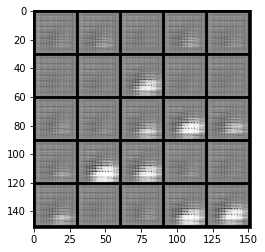

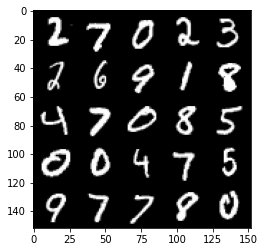

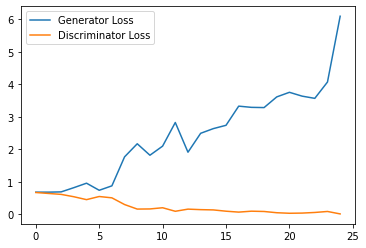

Step 1000: Generator loss: 4.939086291790009, discriminator loss: 0.040518908623605965


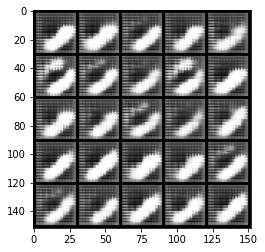

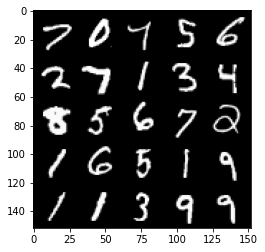

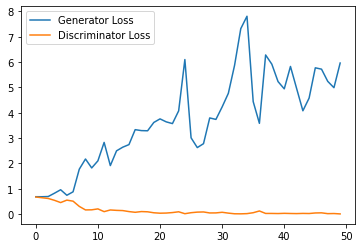

Step 1500: Generator loss: 4.565428176879883, discriminator loss: 0.04681263533048332


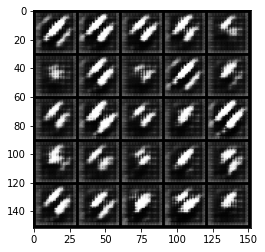

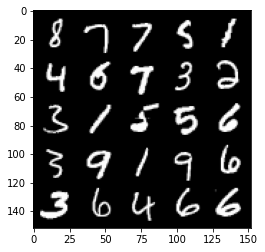

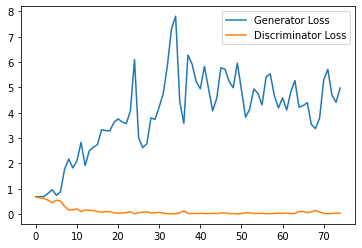

Step 2000: Generator loss: 4.344946732997895, discriminator loss: 0.05225458947569132


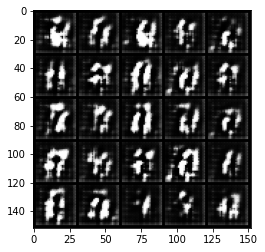

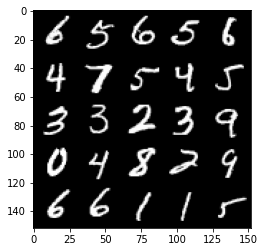

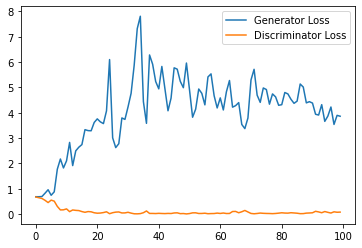

Step 2500: Generator loss: 2.9873279366493226, discriminator loss: 0.2020665982365608


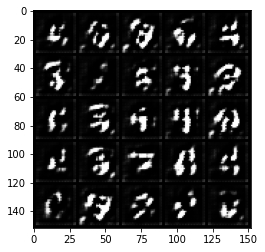

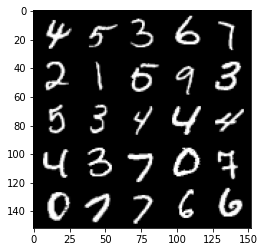

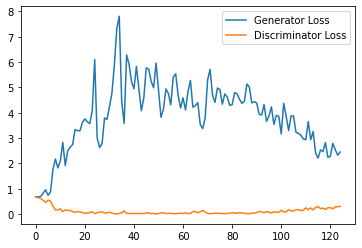

Step 3000: Generator loss: 2.332250506401062, discriminator loss: 0.2964020065963268


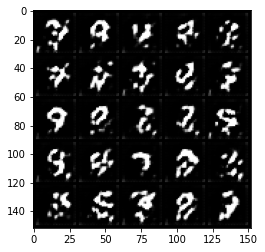

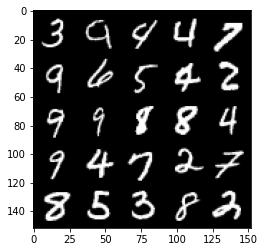

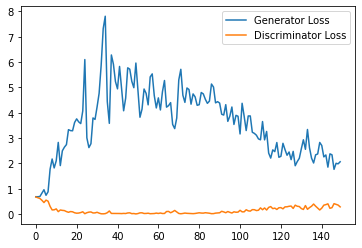

Step 3500: Generator loss: 2.075540022611618, discriminator loss: 0.3224174112677574


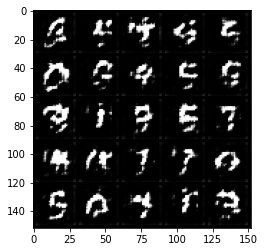

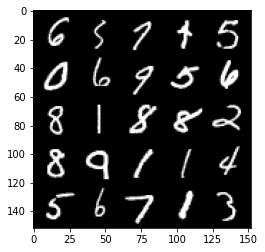

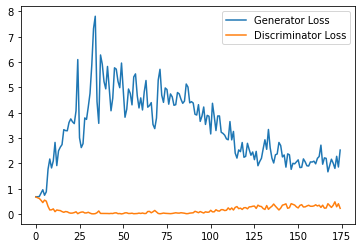

Step 4000: Generator loss: 1.9850131785869598, discriminator loss: 0.33165606316924096


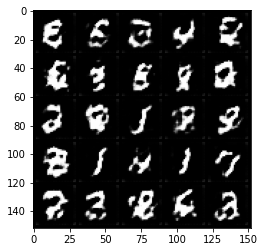

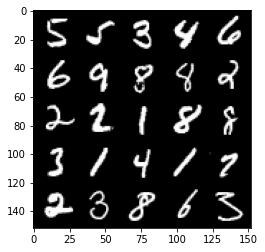

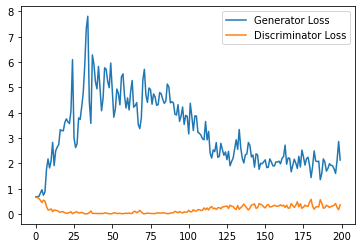

Step 4500: Generator loss: 1.9390651092529296, discriminator loss: 0.3387102567851543


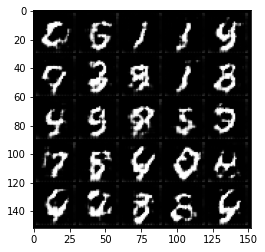

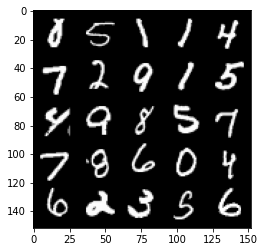

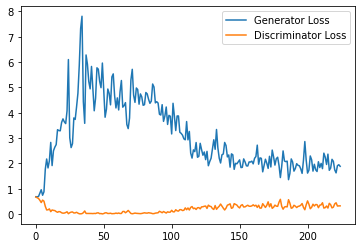

Step 5000: Generator loss: 1.865461319923401, discriminator loss: 0.3599757149219513


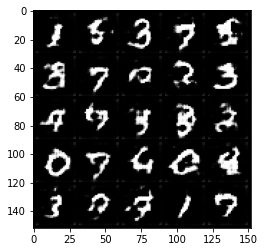

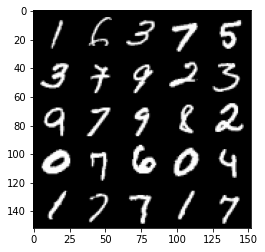

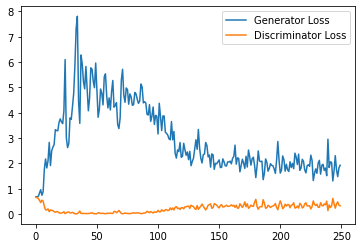

Step 5500: Generator loss: 1.8524219963550568, discriminator loss: 0.38905552127957344


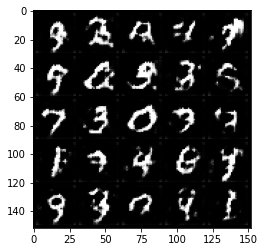

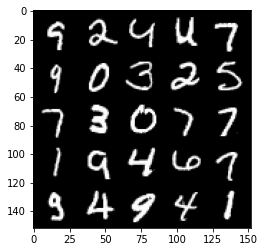

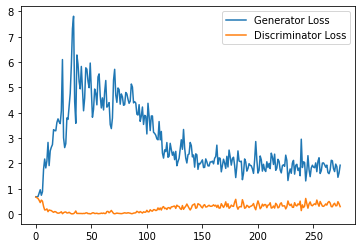

Step 6000: Generator loss: 1.9227323398590088, discriminator loss: 0.3527260122597218


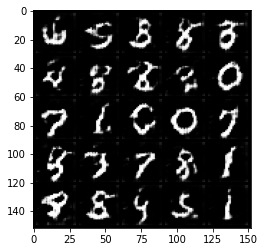

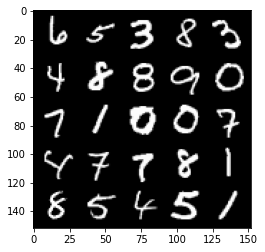

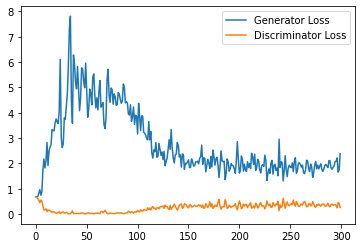

Step 6500: Generator loss: 1.924812183856964, discriminator loss: 0.39301623645424844


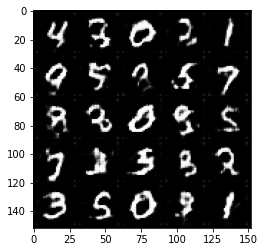

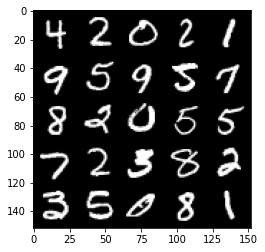

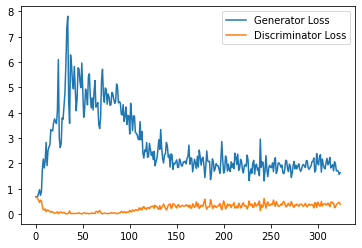

Step 7000: Generator loss: 1.5775679171085357, discriminator loss: 0.4162570669054985


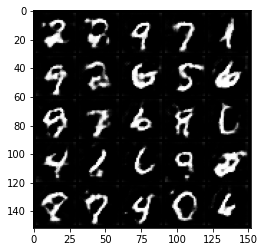

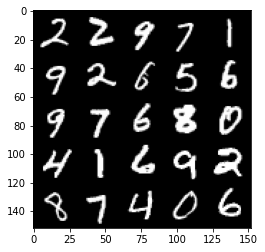

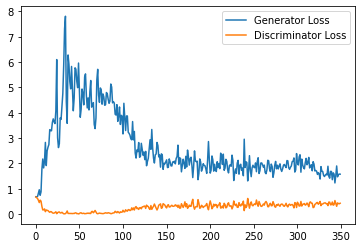

Step 7500: Generator loss: 1.5903791170120238, discriminator loss: 0.43784222412109375


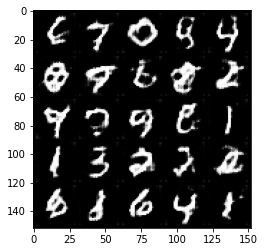

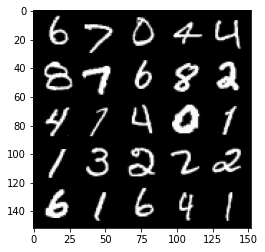

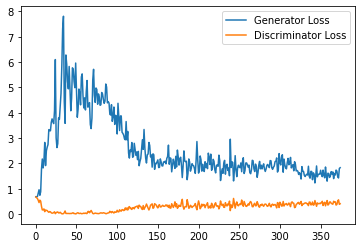

Step 8000: Generator loss: 1.499613232254982, discriminator loss: 0.46139058977365494


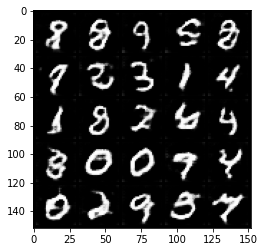

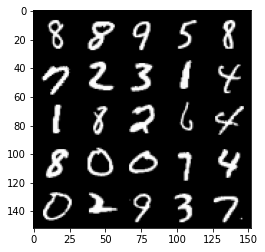

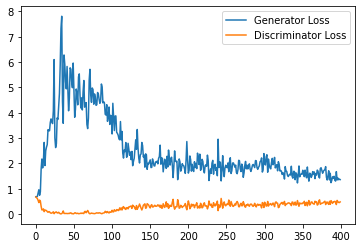

Step 8500: Generator loss: 1.388158497452736, discriminator loss: 0.4885283659100533


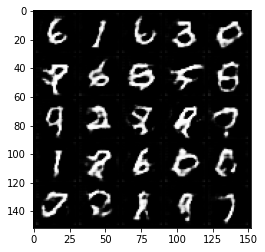

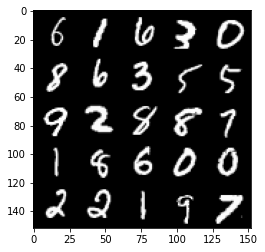

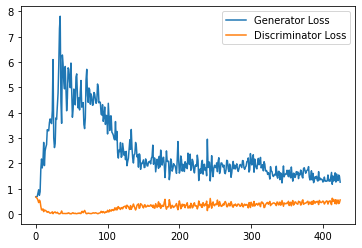

Step 9000: Generator loss: 1.3406266767978667, discriminator loss: 0.4868360963463783


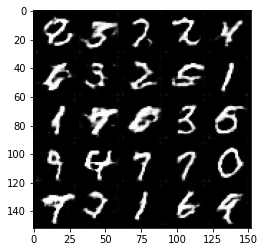

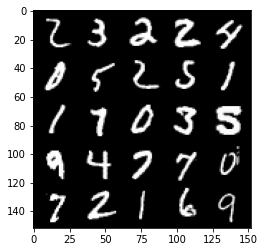

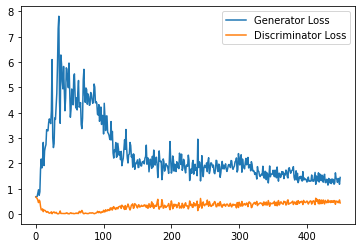

Step 9500: Generator loss: 1.3755902210474014, discriminator loss: 0.5067168461084366


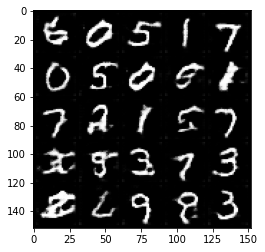

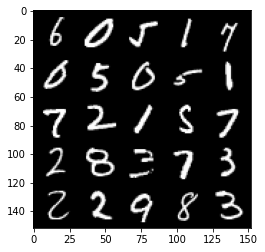

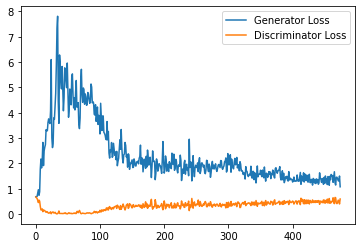

Step 10000: Generator loss: 1.2977195717096328, discriminator loss: 0.5165708342194557


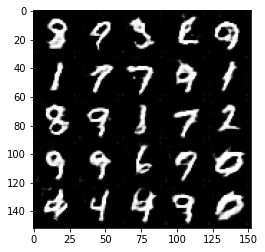

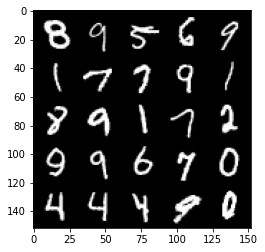

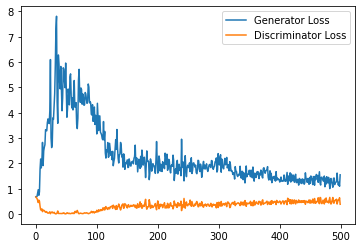

Step 10500: Generator loss: 1.237886075258255, discriminator loss: 0.5292043740153313


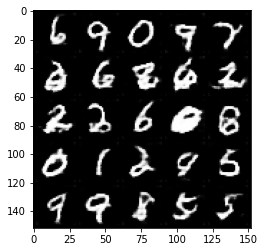

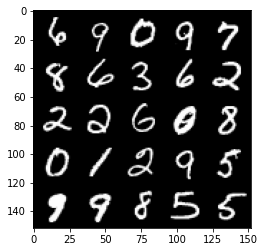

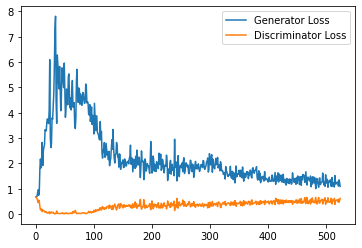

Step 11000: Generator loss: 1.2460011537075042, discriminator loss: 0.5418845506310463


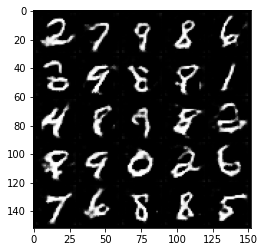

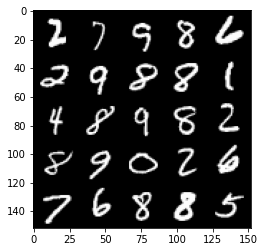

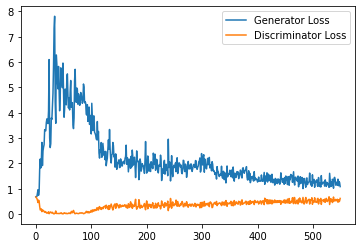

Step 11500: Generator loss: 1.2049694329500198, discriminator loss: 0.5473596906661987


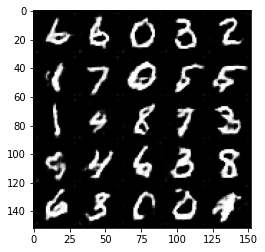

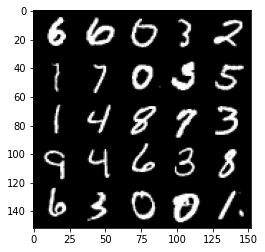

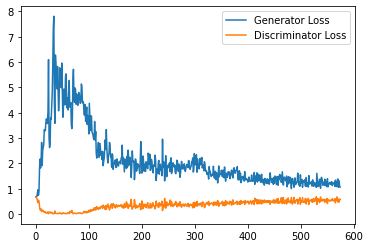

Step 12000: Generator loss: 1.1658338084220887, discriminator loss: 0.5529729579091072


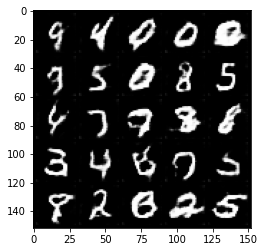

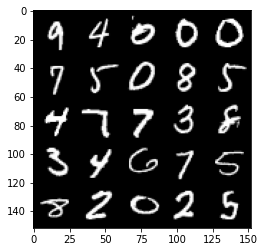

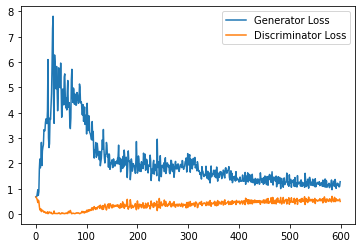

Step 12500: Generator loss: 1.1388420728445052, discriminator loss: 0.5665767230391502


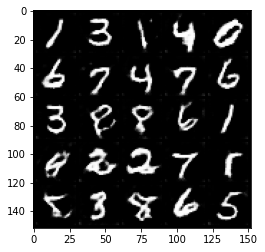

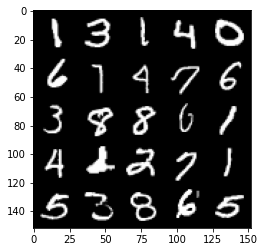

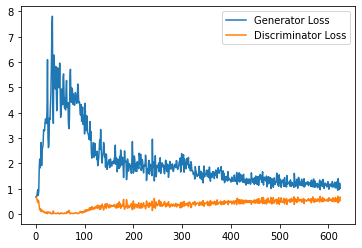

Step 13000: Generator loss: 1.1296819839477539, discriminator loss: 0.5680434133410454


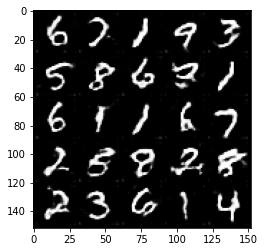

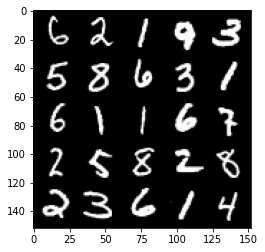

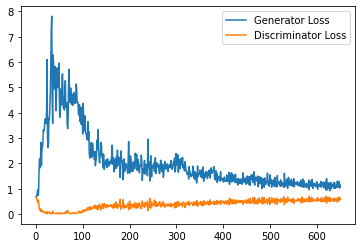

Step 13500: Generator loss: 1.1433646094799041, discriminator loss: 0.5746639001369477


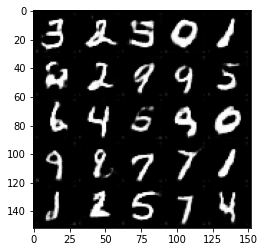

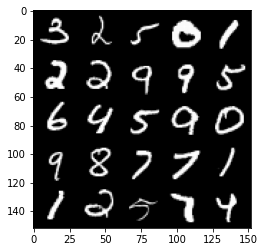

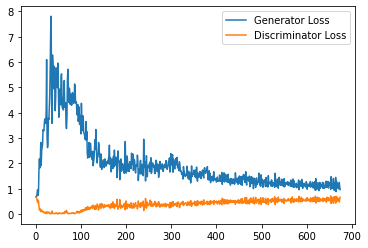

Step 14000: Generator loss: 1.0794562973976136, discriminator loss: 0.5842088863253594


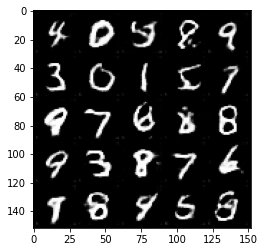

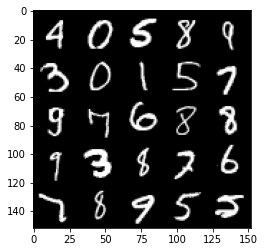

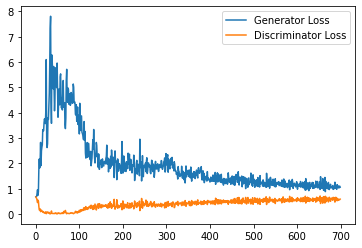

Step 14500: Generator loss: 1.0980376443862916, discriminator loss: 0.5802196640968322


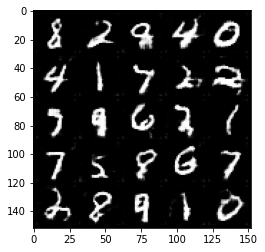

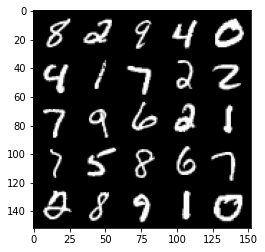

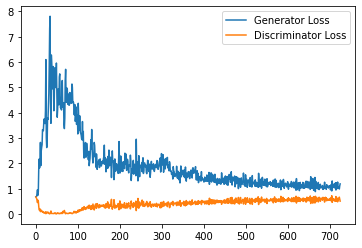

Step 15000: Generator loss: 1.071431389093399, discriminator loss: 0.5831862919330597


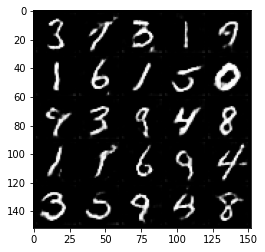

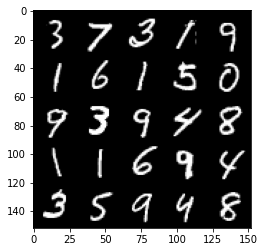

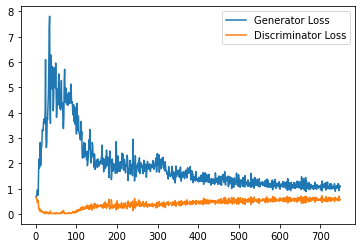

Step 15500: Generator loss: 1.0827340993881225, discriminator loss: 0.5831826551556587


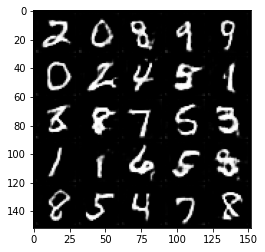

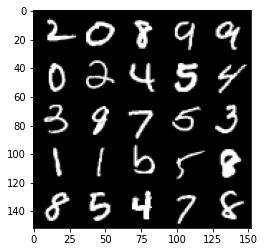

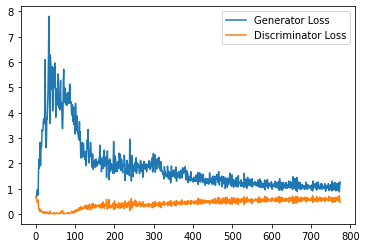

Step 16000: Generator loss: 1.0078568803071977, discriminator loss: 0.5907229589223861


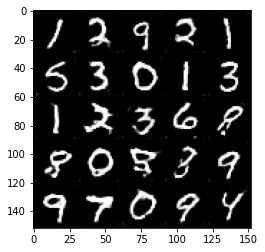

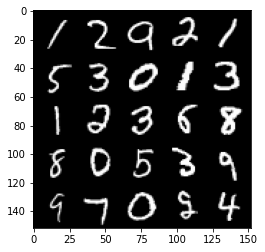

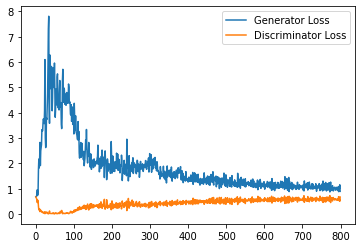

Step 16500: Generator loss: 1.093205151796341, discriminator loss: 0.5908994017839432


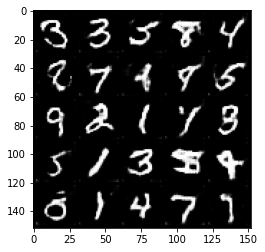

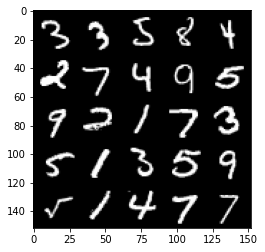

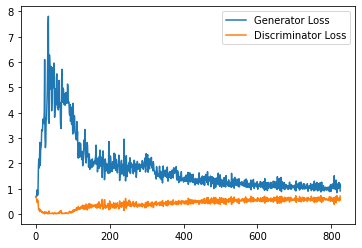

Step 17000: Generator loss: 1.0417448624372483, discriminator loss: 0.5932427434325218


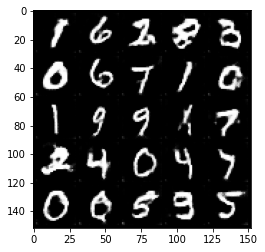

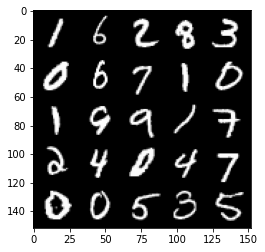

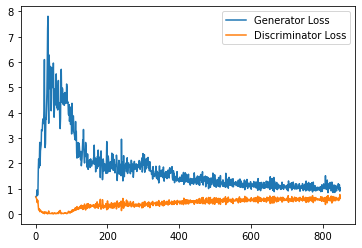

Step 17500: Generator loss: 1.071991219639778, discriminator loss: 0.5888165786266327


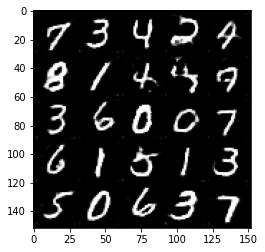

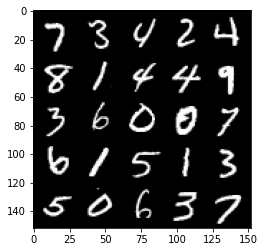

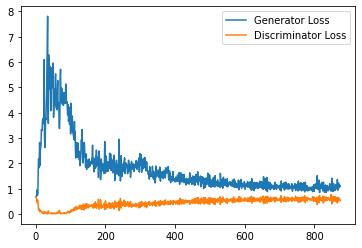

Step 18000: Generator loss: 1.030897201538086, discriminator loss: 0.5969305906891823


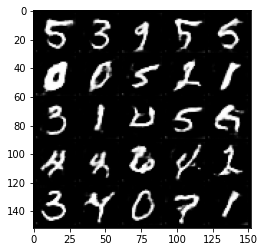

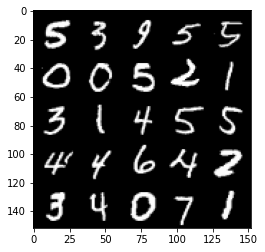

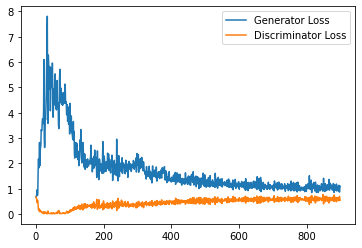

Step 18500: Generator loss: 1.0152049771547318, discriminator loss: 0.5933311527967453


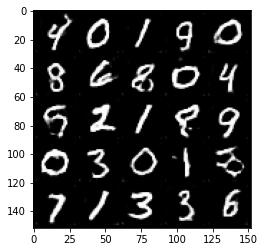

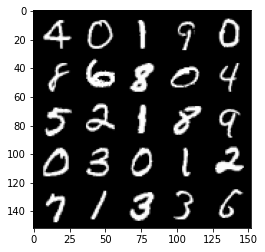

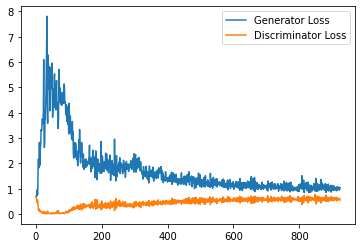

Step 19000: Generator loss: 1.0356757375001908, discriminator loss: 0.5957744581699371


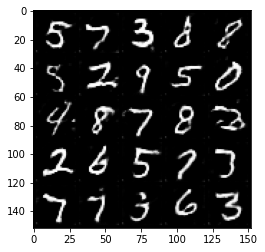

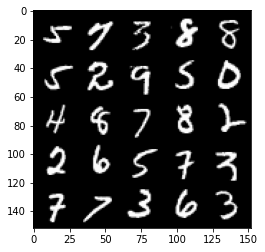

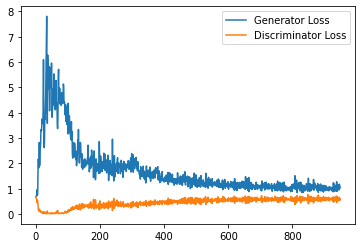

Step 19500: Generator loss: 0.9830148015022278, discriminator loss: 0.6067685897350311


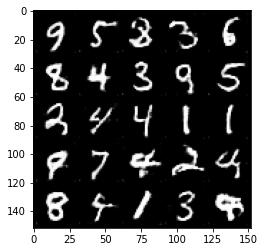

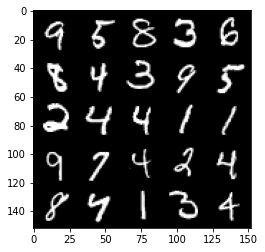

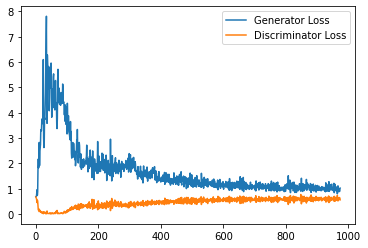

Step 20000: Generator loss: 0.9853294292688369, discriminator loss: 0.6062455028891564


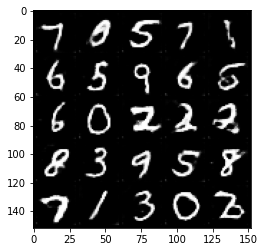

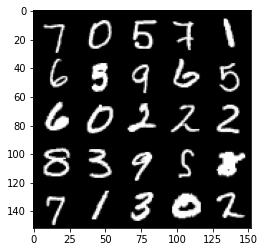

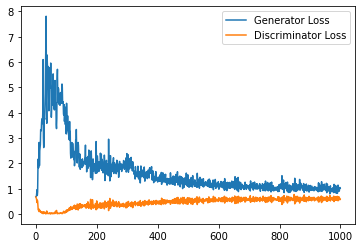

Step 20500: Generator loss: 1.0146976162195205, discriminator loss: 0.6099511909484864


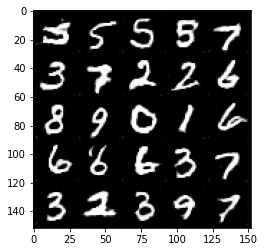

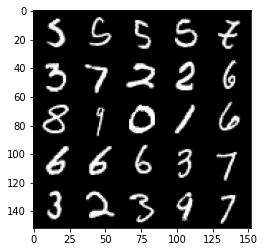

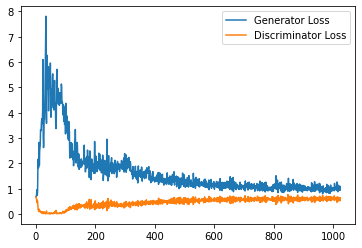

Step 21000: Generator loss: 0.9686616171598434, discriminator loss: 0.6072958365678788


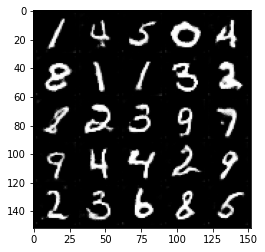

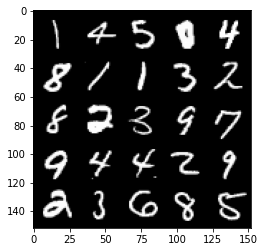

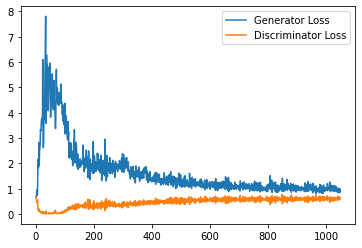

Step 21500: Generator loss: 0.9937958495616913, discriminator loss: 0.610388761818409


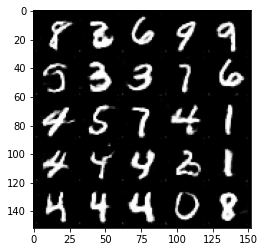

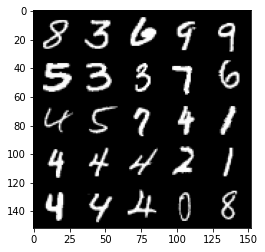

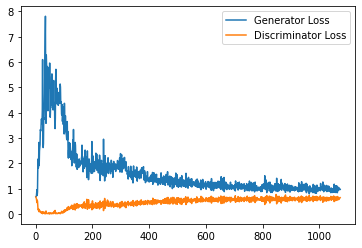

Step 22000: Generator loss: 0.9772712233066558, discriminator loss: 0.6130165172219276


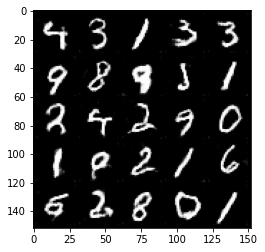

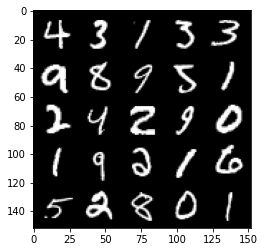

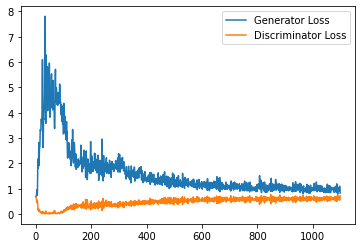

Step 22500: Generator loss: 0.9895570869445801, discriminator loss: 0.6093714089989662


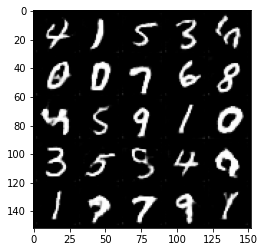

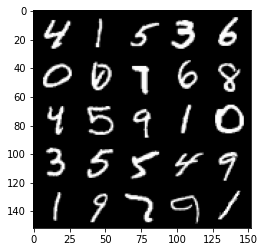

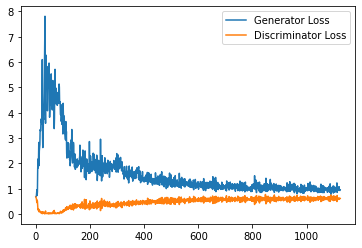

Step 23000: Generator loss: 0.9803144495487213, discriminator loss: 0.618791830599308


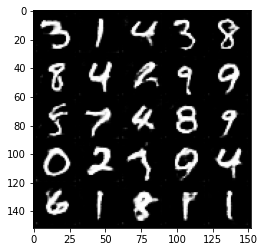

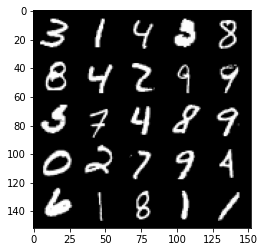

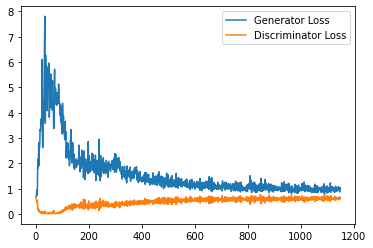

Step 23500: Generator loss: 0.9727686606645584, discriminator loss: 0.6186487813591957


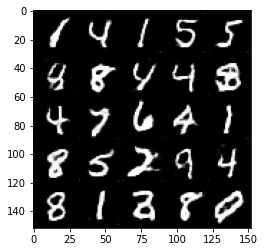

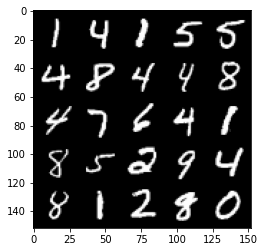

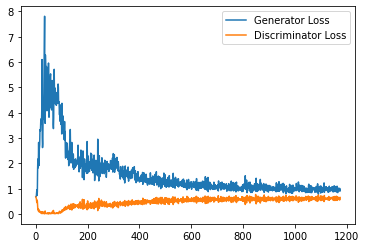

Step 24000: Generator loss: 0.9530498620271682, discriminator loss: 0.6234767868518829


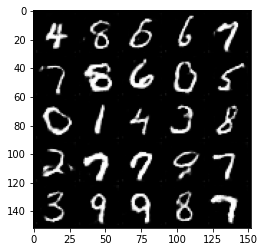

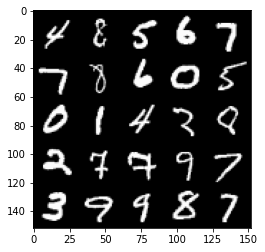

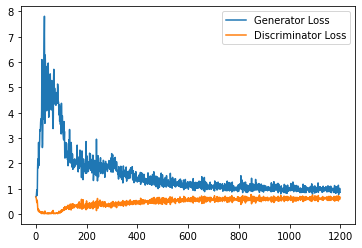

Step 24500: Generator loss: 0.9598658229112625, discriminator loss: 0.620894356906414


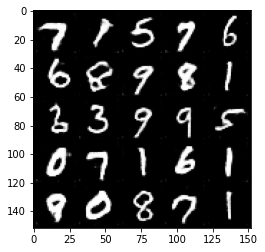

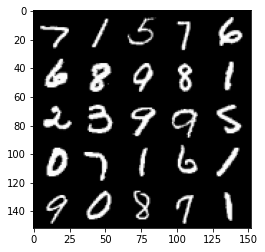

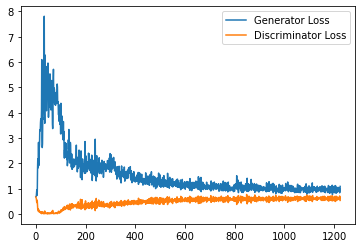

Step 25000: Generator loss: 0.9644138476848603, discriminator loss: 0.6193924325704575


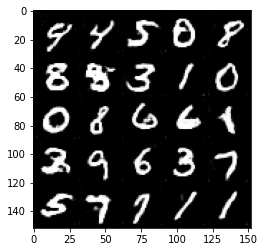

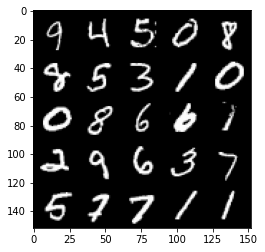

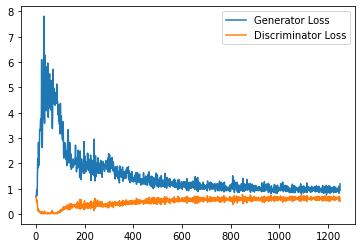

Step 25500: Generator loss: 0.9617872306108475, discriminator loss: 0.6182572056055069


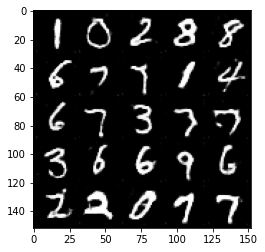

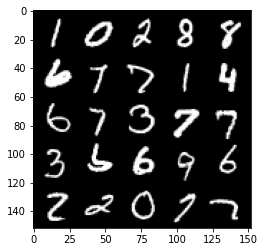

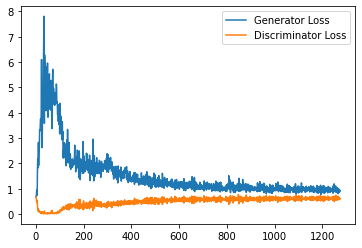

Step 26000: Generator loss: 0.946058582663536, discriminator loss: 0.6212969999313355


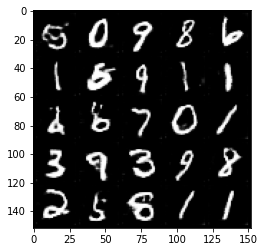

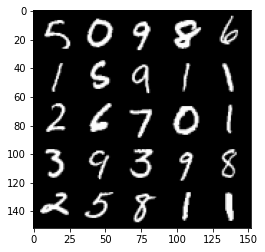

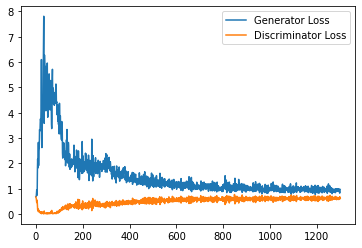

Step 26500: Generator loss: 0.9664056713581085, discriminator loss: 0.6233112332820893


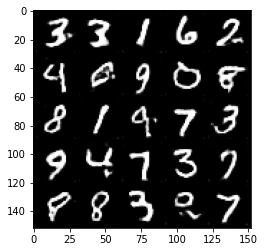

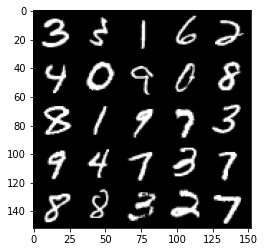

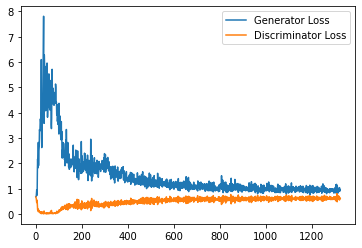

Step 27000: Generator loss: 0.9332012304067612, discriminator loss: 0.6272894539833069


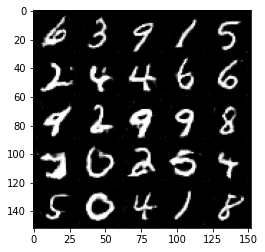

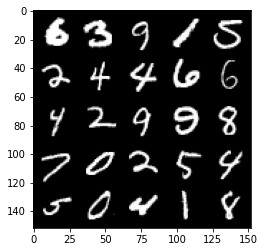

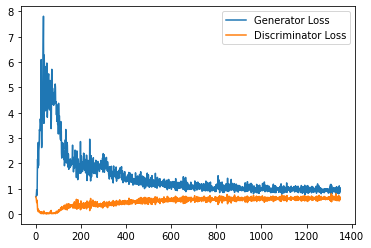

Step 27500: Generator loss: 0.9335420877933502, discriminator loss: 0.6266162875890732


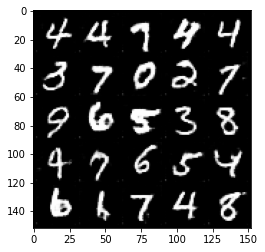

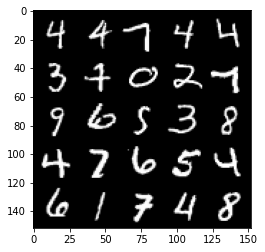

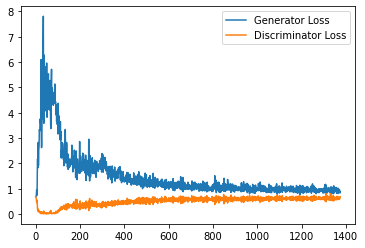

Step 28000: Generator loss: 0.9428916032314301, discriminator loss: 0.6214364485144616


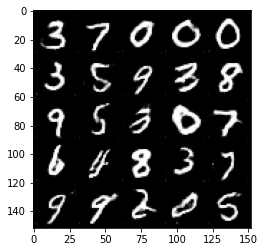

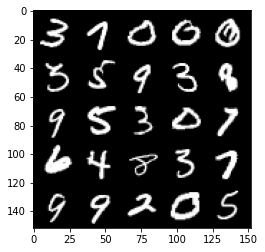

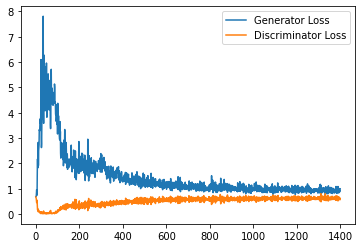

Step 28500: Generator loss: 0.9148866839408875, discriminator loss: 0.629912424325943


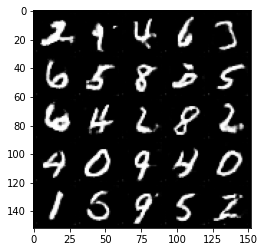

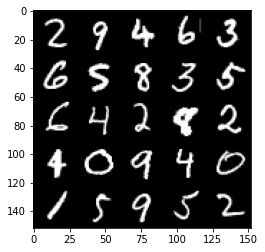

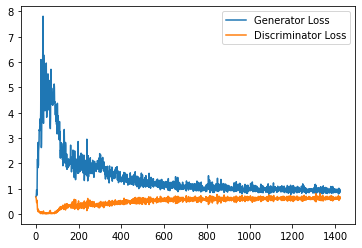

Step 29000: Generator loss: 0.9370519506931305, discriminator loss: 0.629323485314846


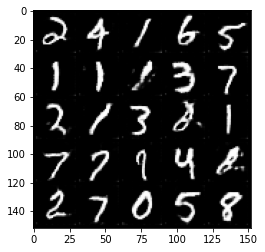

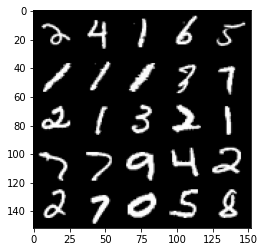

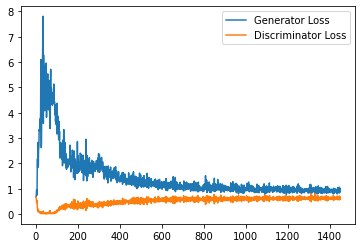

Step 29500: Generator loss: 0.9641834455132484, discriminator loss: 0.6254787214994431


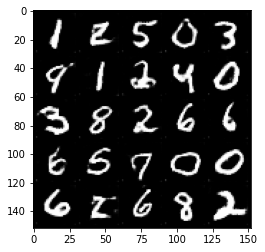

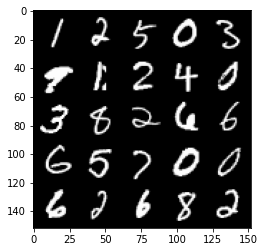

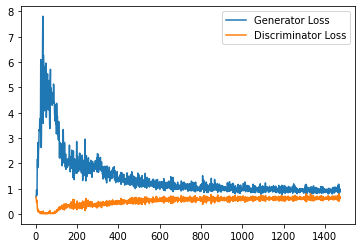

Step 30000: Generator loss: 0.9274792630672455, discriminator loss: 0.6277094306349754


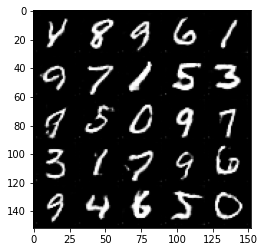

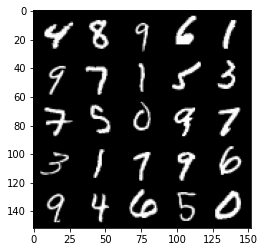

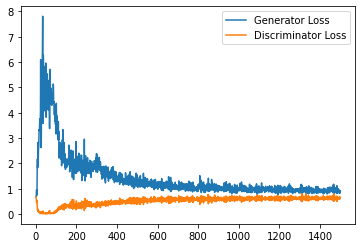

Step 30500: Generator loss: 0.9004816310405731, discriminator loss: 0.6230425218343735


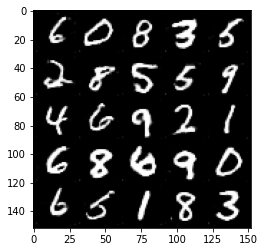

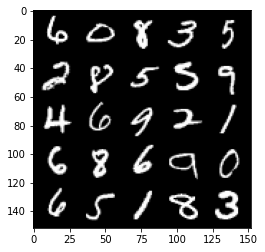

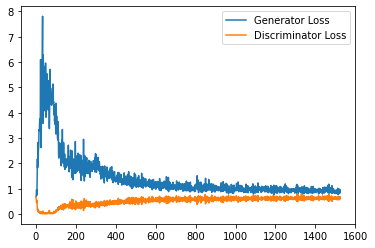

Step 31000: Generator loss: 0.9251829311847687, discriminator loss: 0.6265663561224938


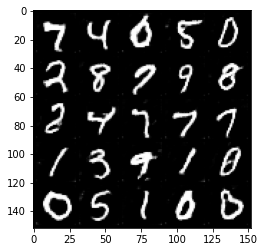

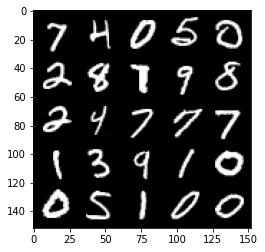

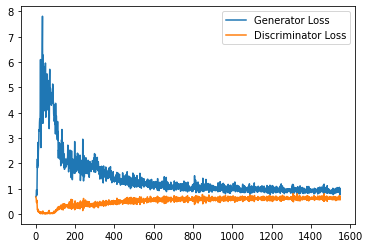

Step 31500: Generator loss: 0.9316781415939331, discriminator loss: 0.628083444416523


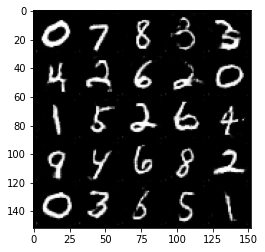

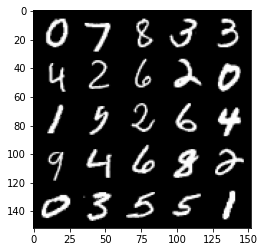

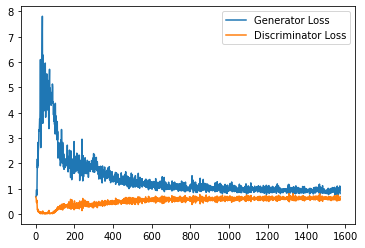

Step 32000: Generator loss: 0.9297730512619019, discriminator loss: 0.6224635490179062


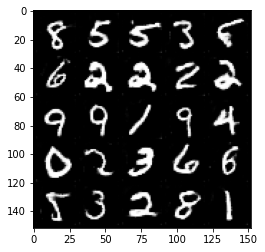

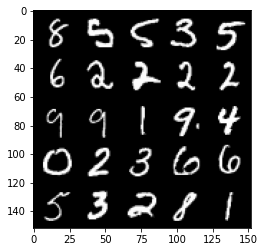

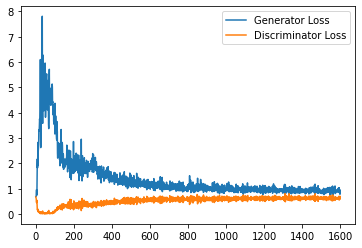

Step 32500: Generator loss: 0.9298418290615081, discriminator loss: 0.6274061047434807


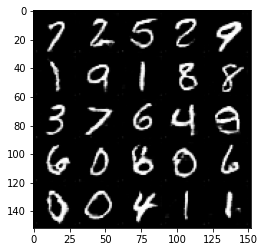

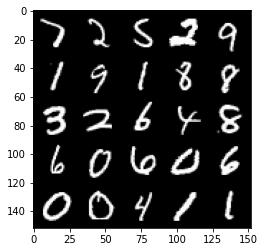

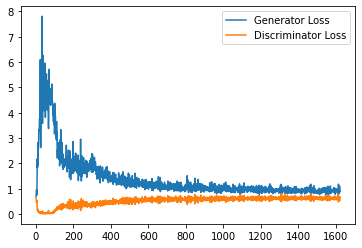

Step 33000: Generator loss: 0.9335883040428161, discriminator loss: 0.6267360783219338


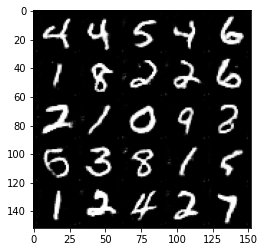

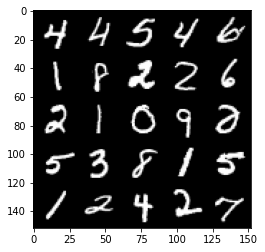

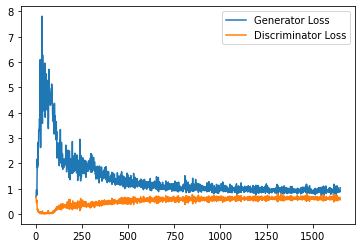

Step 33500: Generator loss: 0.9278920043706894, discriminator loss: 0.6329983456730842


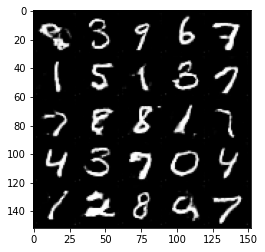

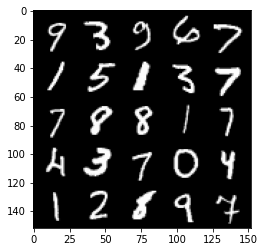

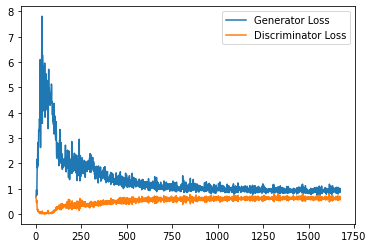

Step 34000: Generator loss: 0.9175136532783509, discriminator loss: 0.6400718190073967


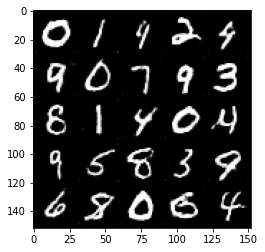

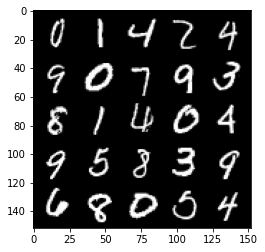

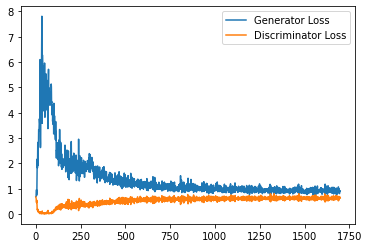

Step 34500: Generator loss: 0.894069670677185, discriminator loss: 0.6292817754745483


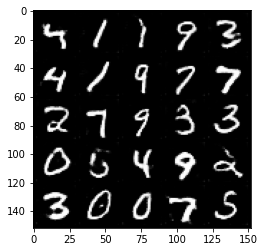

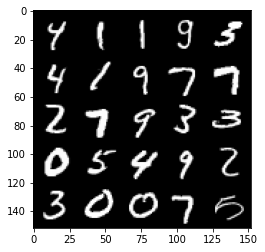

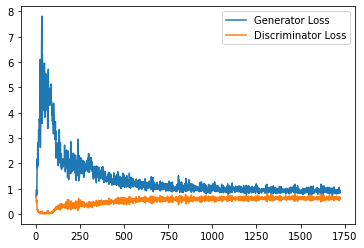

Step 35000: Generator loss: 0.9035878955125809, discriminator loss: 0.627625107228756


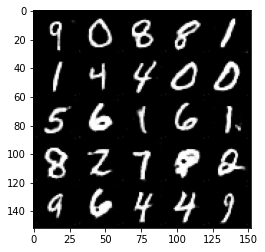

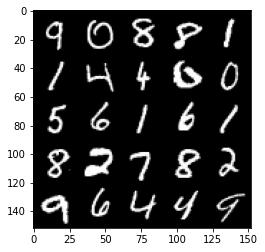

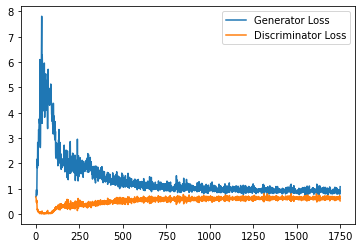

Step 35500: Generator loss: 0.8933232842683793, discriminator loss: 0.6356562370061875


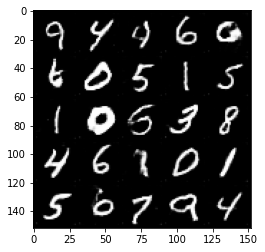

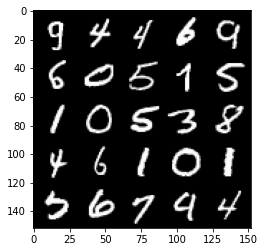

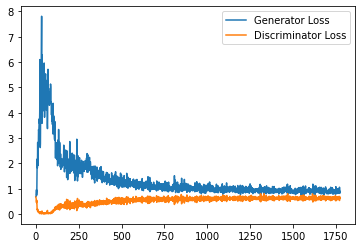

Step 36000: Generator loss: 0.9043838971853256, discriminator loss: 0.6293468869924546


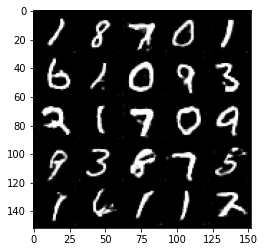

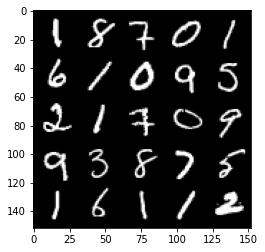

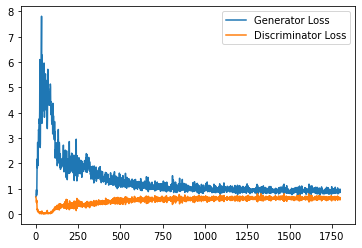

Step 36500: Generator loss: 0.8767557258605957, discriminator loss: 0.6361770242452621


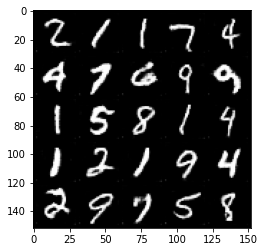

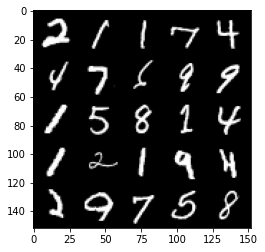

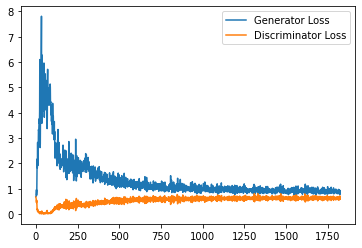

Step 37000: Generator loss: 0.8946271342039108, discriminator loss: 0.6303520031571388


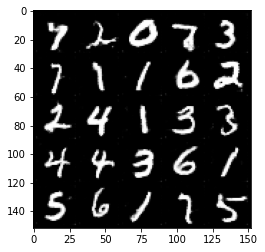

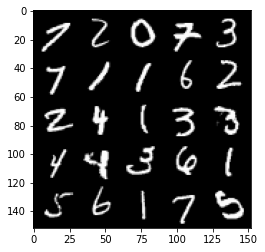

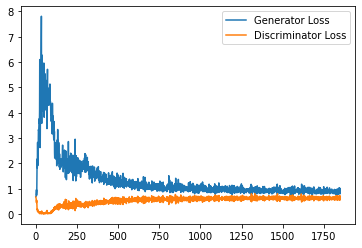

Step 37500: Generator loss: 0.9019642301797867, discriminator loss: 0.6330747229456901


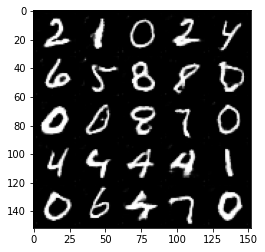

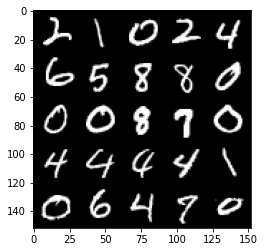

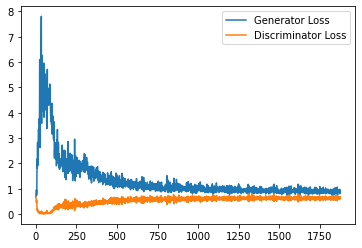

Step 38000: Generator loss: 0.9167691485881806, discriminator loss: 0.6300151462554932


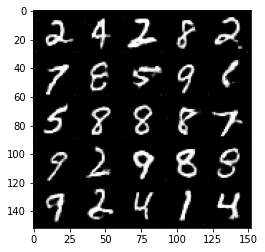

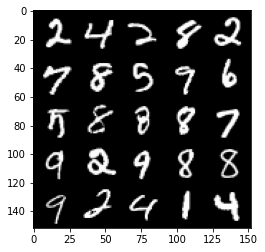

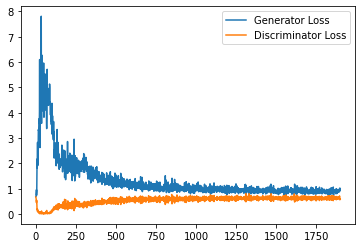

Step 38500: Generator loss: 0.9119778335094452, discriminator loss: 0.6327691940069199


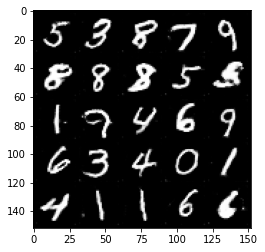

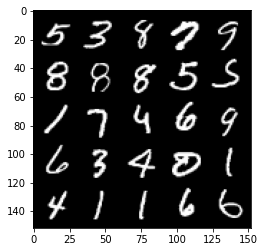

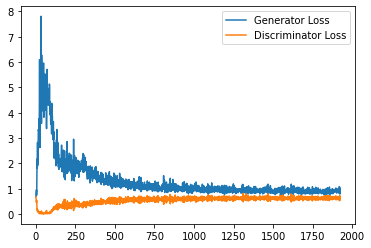

Step 39000: Generator loss: 0.9112524273395538, discriminator loss: 0.6236036754250527


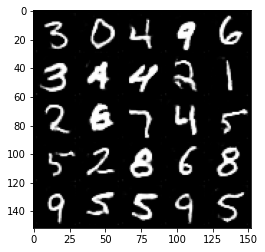

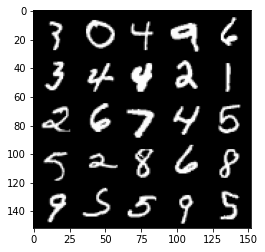

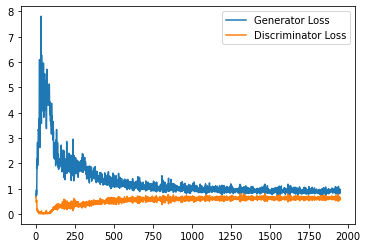

Step 39500: Generator loss: 0.873761873960495, discriminator loss: 0.6288592981100083


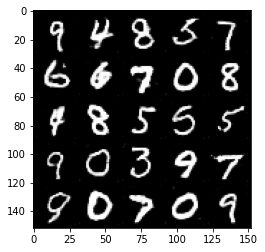

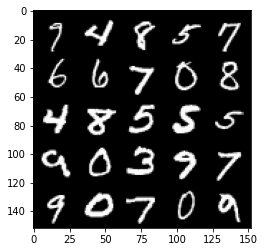

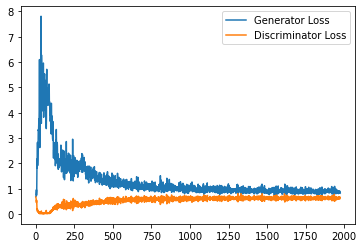

Step 40000: Generator loss: 0.8940824131965637, discriminator loss: 0.6266425552368164


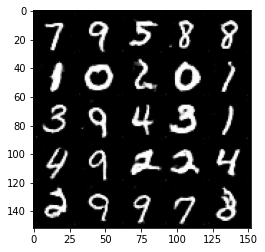

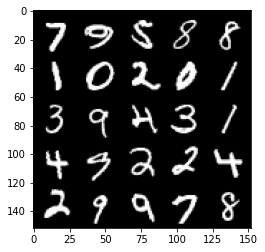

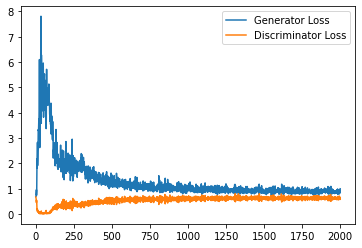

Step 40500: Generator loss: 0.904590599656105, discriminator loss: 0.6350769273042679


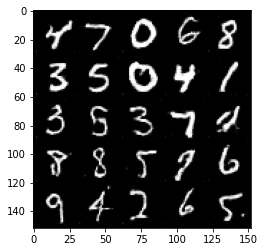

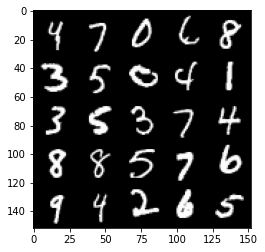

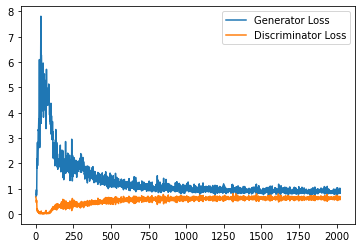

Step 41000: Generator loss: 0.8914209779500961, discriminator loss: 0.628741742014885


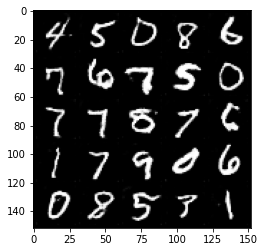

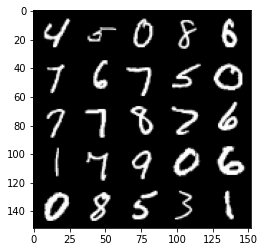

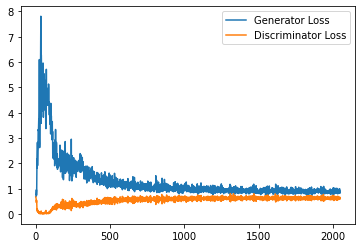

Step 41500: Generator loss: 0.9244672818183899, discriminator loss: 0.632253888130188


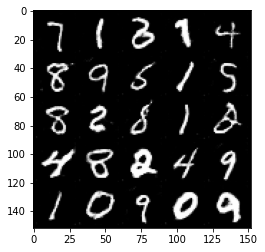

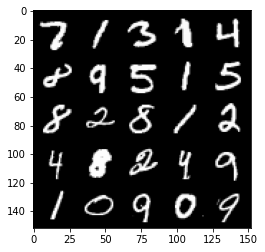

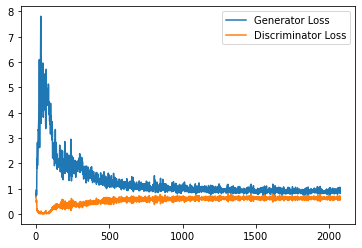

Step 42000: Generator loss: 0.8816005214452743, discriminator loss: 0.6319524445533753


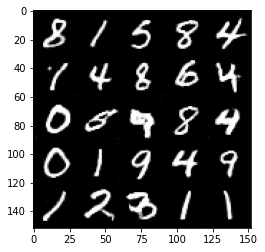

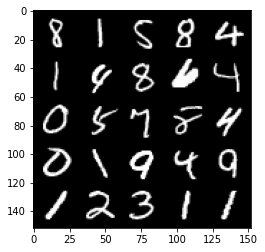

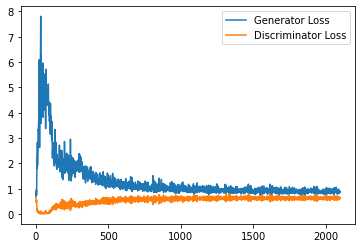

Step 42500: Generator loss: 0.8976224693059921, discriminator loss: 0.6277679765820503


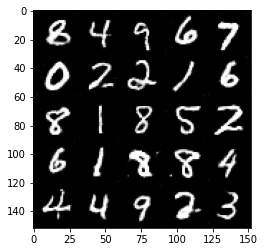

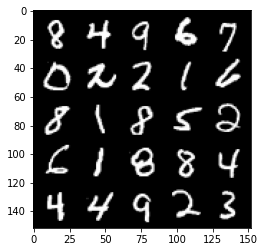

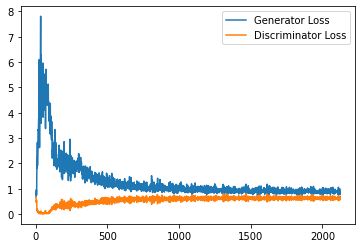

Step 43000: Generator loss: 0.8910661519765853, discriminator loss: 0.6265143055915833


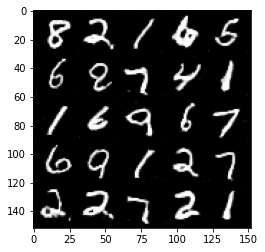

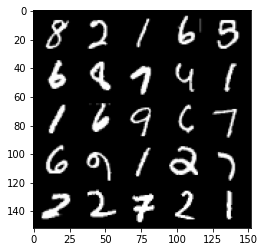

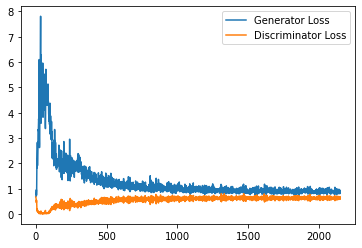

Step 43500: Generator loss: 0.8980124658346176, discriminator loss: 0.6255815623998642


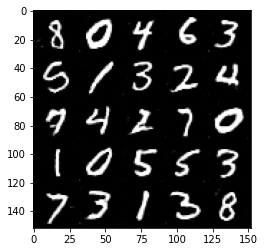

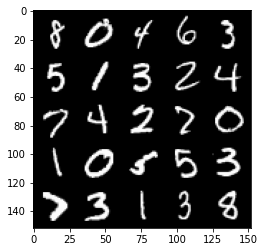

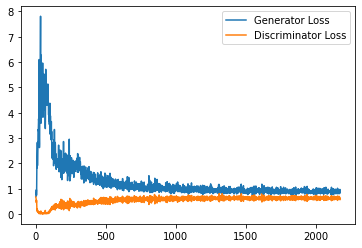

Step 44000: Generator loss: 0.8919409147500992, discriminator loss: 0.6289471015930176


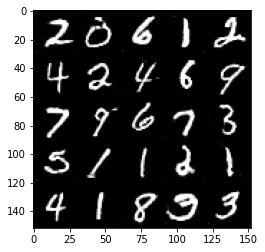

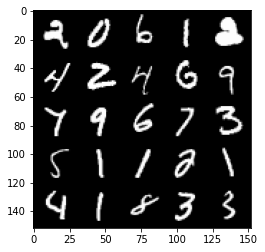

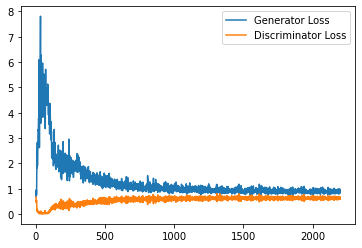

Step 44500: Generator loss: 0.9127029840946197, discriminator loss: 0.6303092131018638


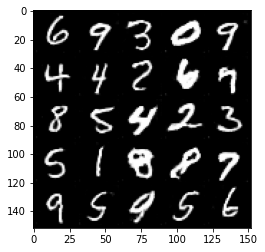

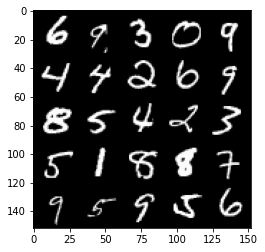

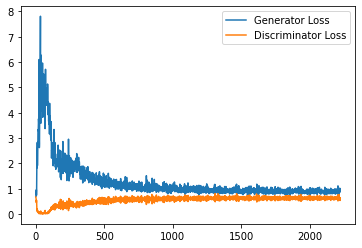

Step 45000: Generator loss: 0.8941708483695984, discriminator loss: 0.6269438556432724


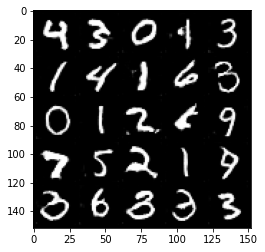

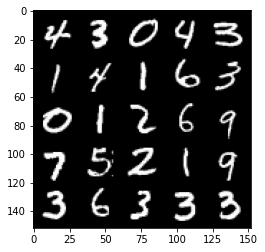

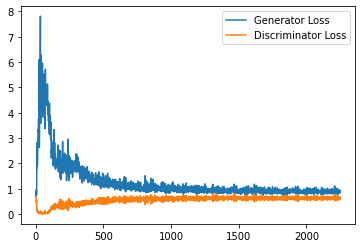

Step 45500: Generator loss: 0.8980848174095154, discriminator loss: 0.6302782320380211


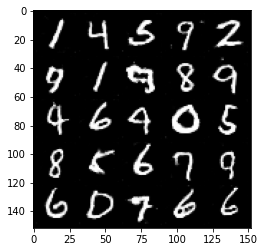

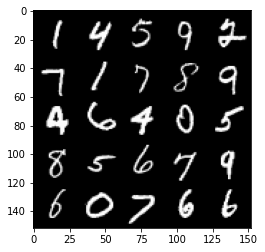

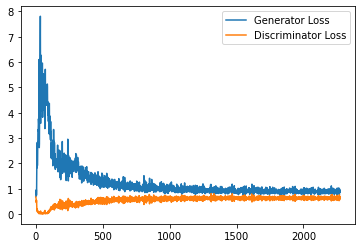

Step 46000: Generator loss: 0.9158489210605621, discriminator loss: 0.622397341966629


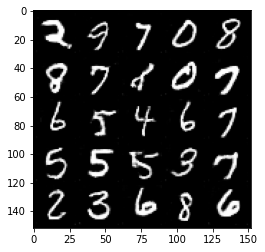

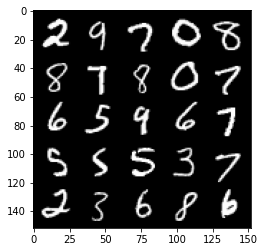

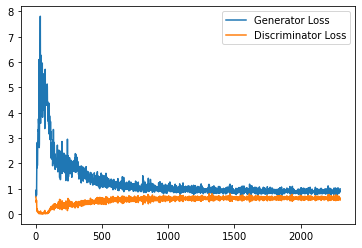

Step 46500: Generator loss: 0.9067014243602752, discriminator loss: 0.6224889514446259


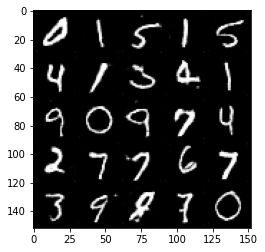

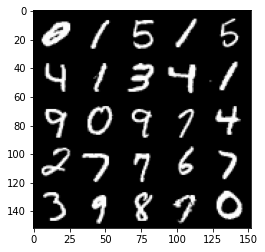

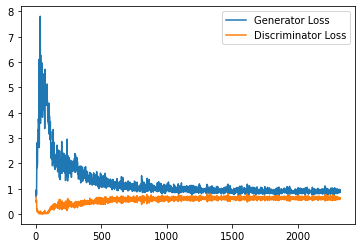

Step 47000: Generator loss: 0.8907418209314346, discriminator loss: 0.6291391070485115


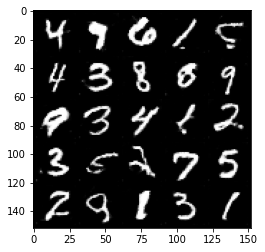

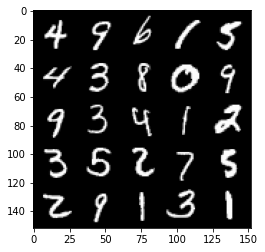

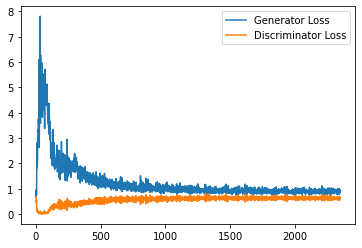

Step 47500: Generator loss: 0.9296310157775879, discriminator loss: 0.6210259409546852


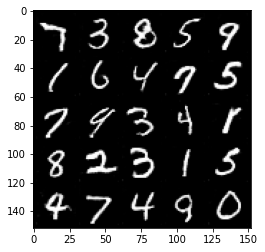

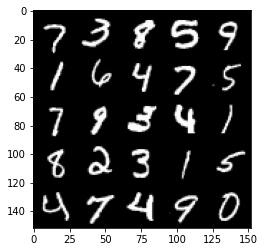

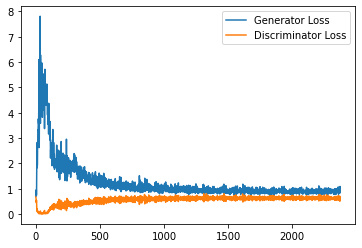

Step 48000: Generator loss: 0.8933464617729187, discriminator loss: 0.6339717292785645


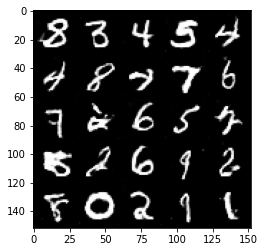

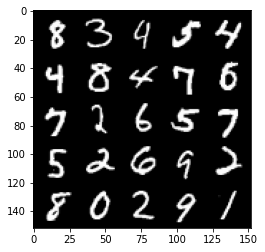

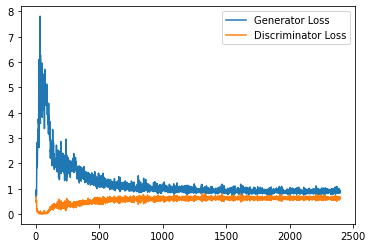

Step 48500: Generator loss: 0.8934979714155197, discriminator loss: 0.6277682502269745


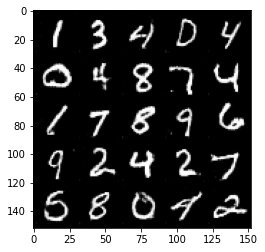

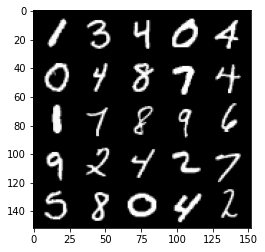

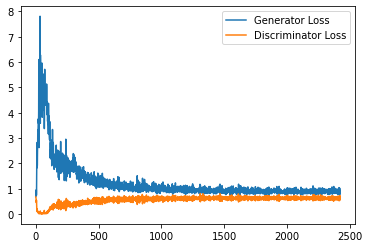

Step 49000: Generator loss: 0.9164789088964462, discriminator loss: 0.6242433791160583


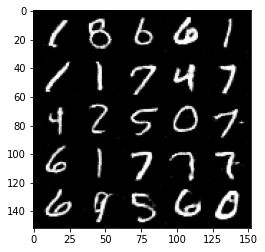

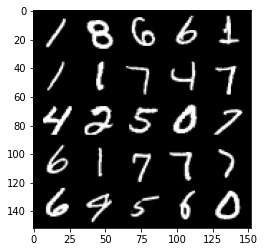

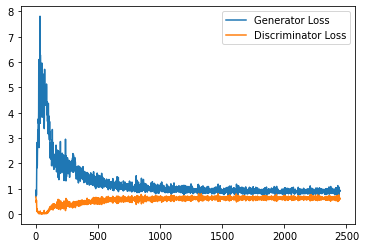

Step 49500: Generator loss: 0.9098553483486176, discriminator loss: 0.6280646770596504


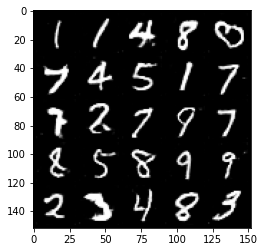

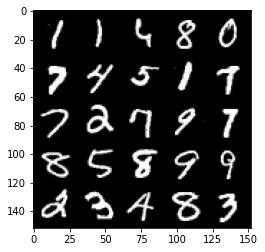

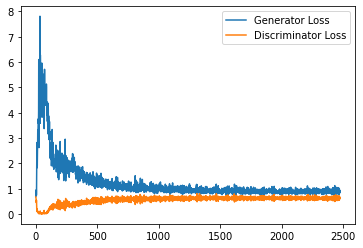

Step 50000: Generator loss: 0.9033420480489731, discriminator loss: 0.6279686343669891


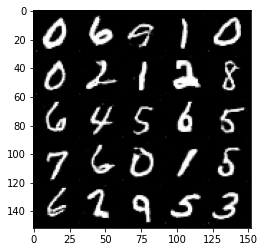

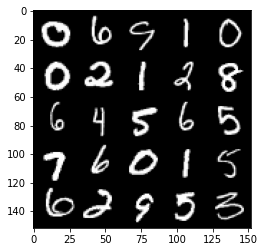

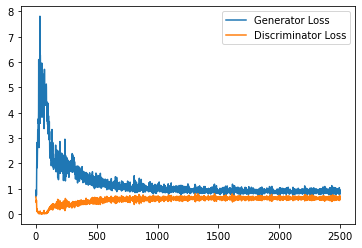

Step 50500: Generator loss: 0.9163389403820038, discriminator loss: 0.6210856233239174


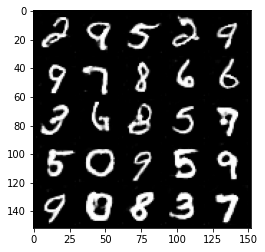

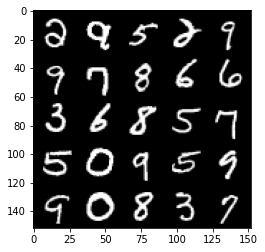

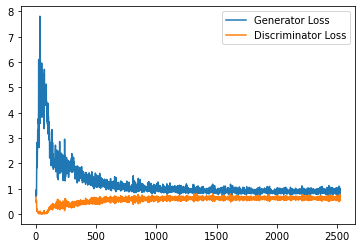

Step 51000: Generator loss: 0.9118147765398026, discriminator loss: 0.6326886742115021


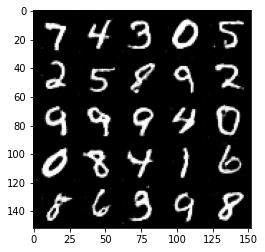

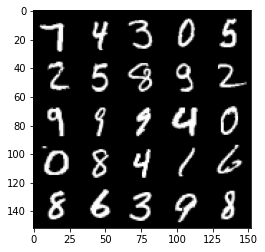

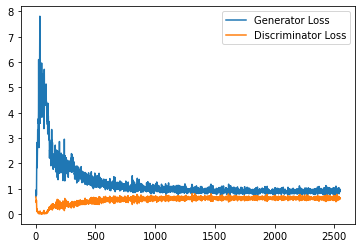

Step 51500: Generator loss: 0.9154036096334457, discriminator loss: 0.6261956395506859


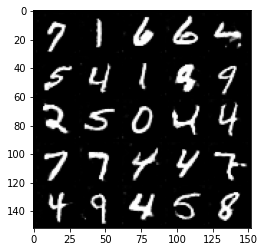

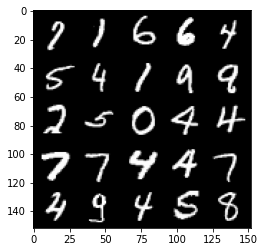

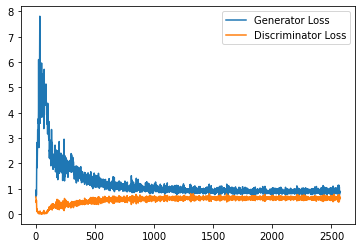

Step 52000: Generator loss: 0.895625571846962, discriminator loss: 0.6286943532824516


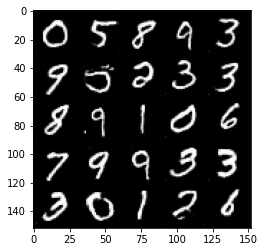

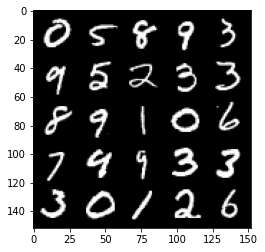

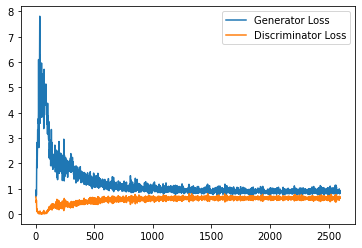

Step 52500: Generator loss: 0.894940344452858, discriminator loss: 0.6270873546600342


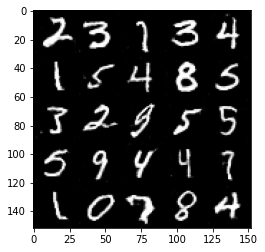

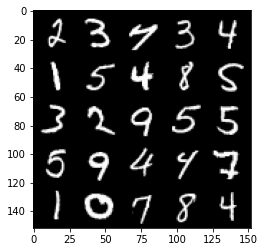

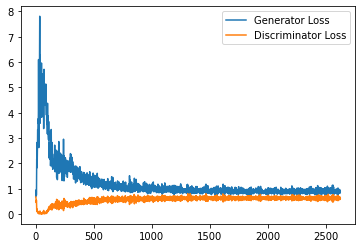

Step 53000: Generator loss: 0.9063924733400345, discriminator loss: 0.6292172703146934


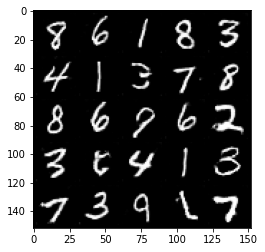

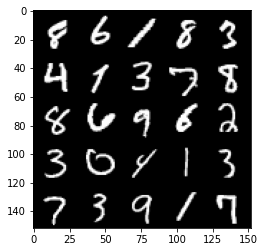

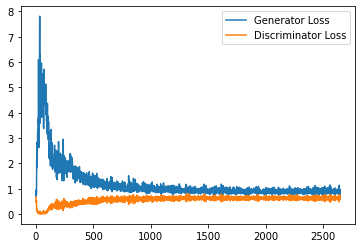

Step 53500: Generator loss: 0.8988368256092072, discriminator loss: 0.6260383996963501


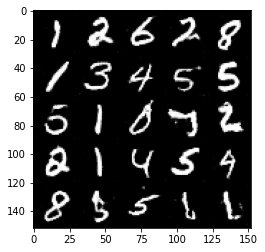

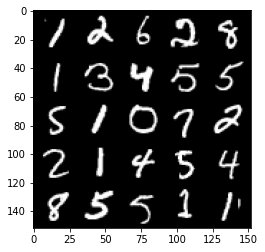

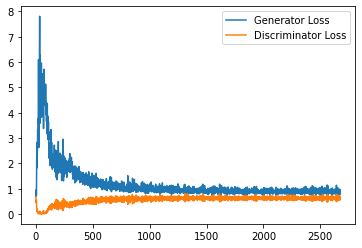

Step 54000: Generator loss: 0.9100343191623688, discriminator loss: 0.6238060849905014


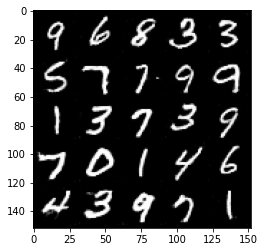

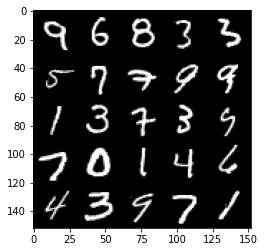

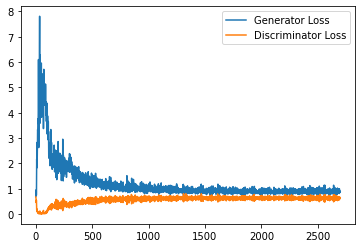

Step 54500: Generator loss: 0.9137687458992004, discriminator loss: 0.6243027337789535


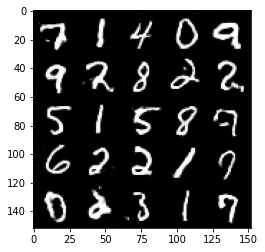

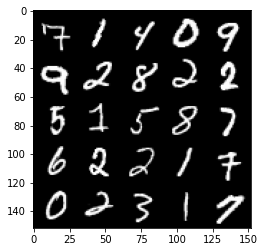

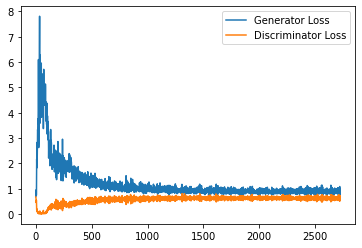

Step 55000: Generator loss: 0.9264314440488816, discriminator loss: 0.6240180549025536


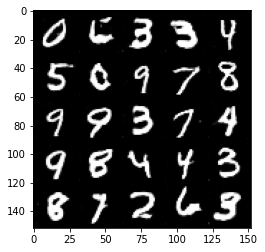

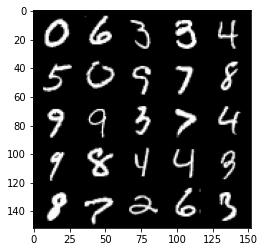

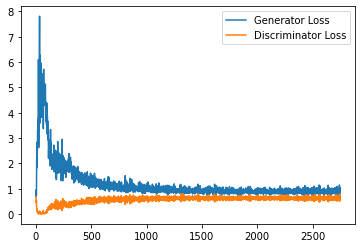

Step 55500: Generator loss: 0.9025278210639953, discriminator loss: 0.6305439069271087


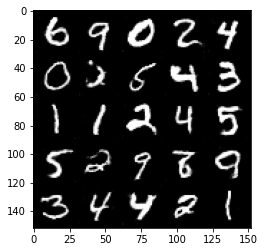

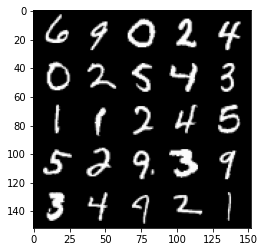

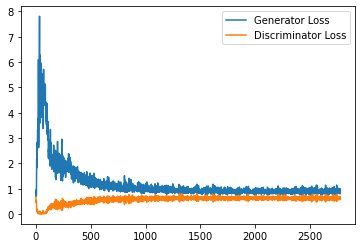

Step 56000: Generator loss: 0.8968534233570099, discriminator loss: 0.6265383575558663


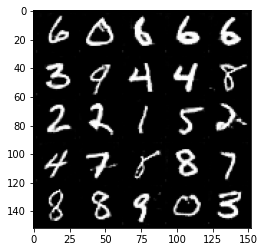

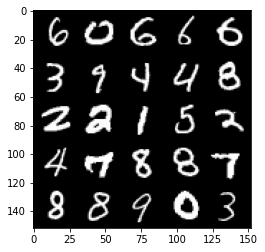

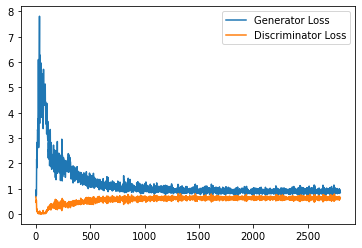

Step 56500: Generator loss: 0.9099207756519317, discriminator loss: 0.6271709032654762


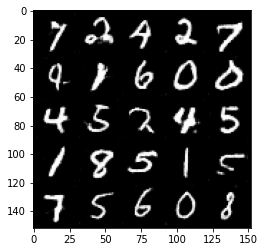

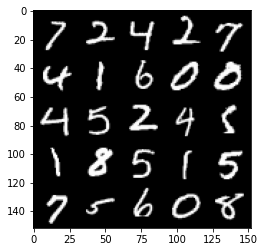

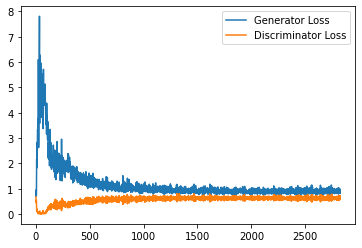

Step 57000: Generator loss: 0.9144974516630173, discriminator loss: 0.6262797195911407


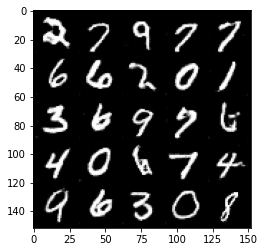

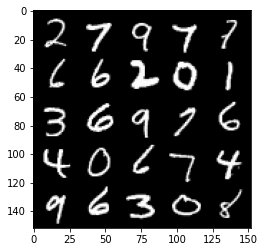

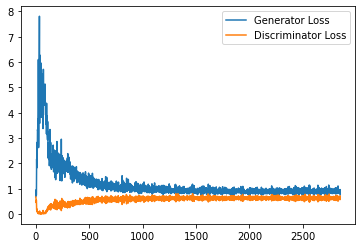

Step 57500: Generator loss: 0.9268987785577774, discriminator loss: 0.6227190599441529


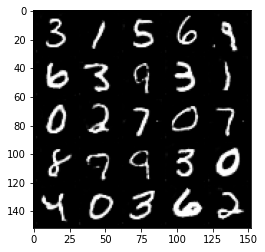

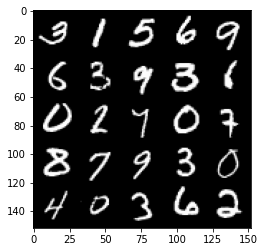

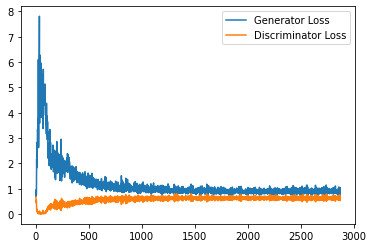

Step 58000: Generator loss: 0.9042737262248993, discriminator loss: 0.6278221611380577


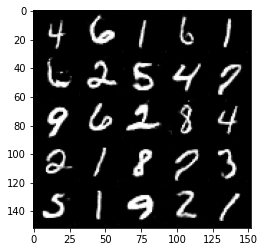

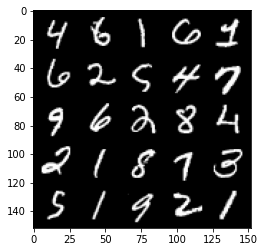

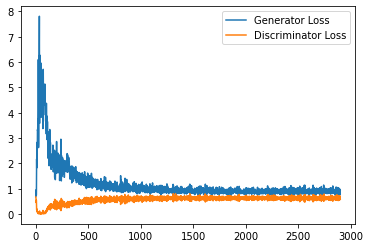

Step 58500: Generator loss: 0.9127877385616302, discriminator loss: 0.6296254216432572


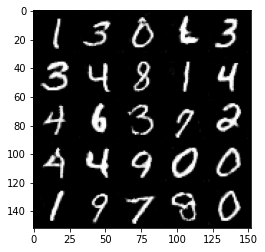

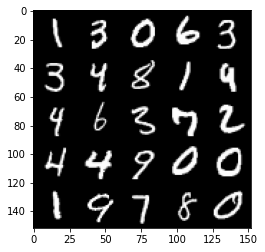

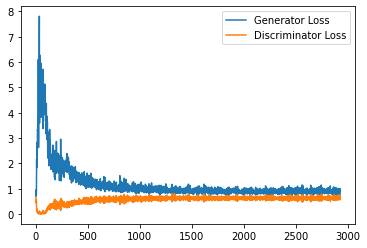

Step 59000: Generator loss: 0.9045509983301163, discriminator loss: 0.6197900329828262


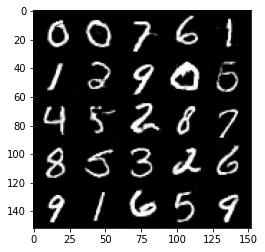

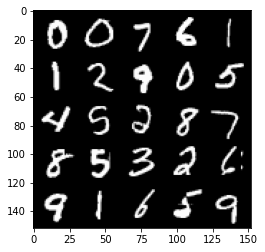

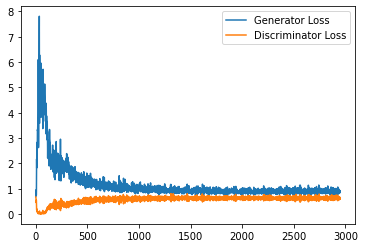

Step 59500: Generator loss: 0.8875856012105942, discriminator loss: 0.6253488534688949


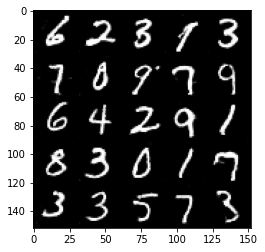

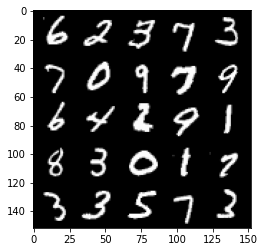

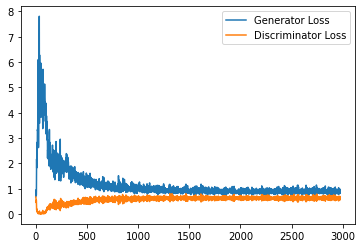

Step 60000: Generator loss: 0.9228753626346589, discriminator loss: 0.6170016256570816


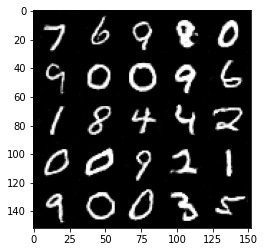

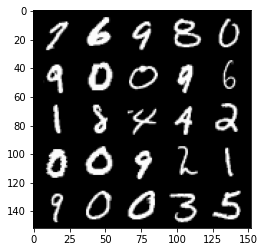

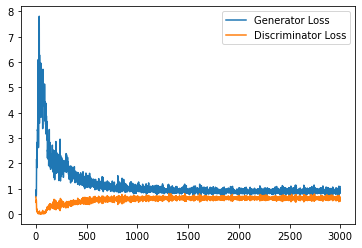

Step 60500: Generator loss: 0.925537515282631, discriminator loss: 0.6207803941369057


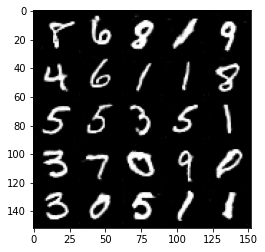

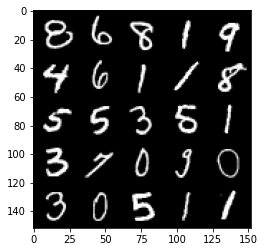

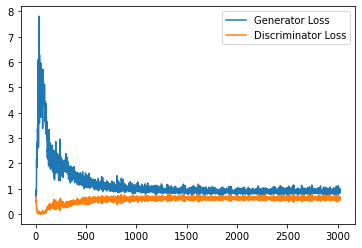

Step 61000: Generator loss: 0.9094584867954254, discriminator loss: 0.6263151511549949


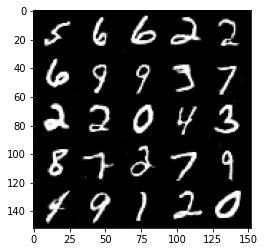

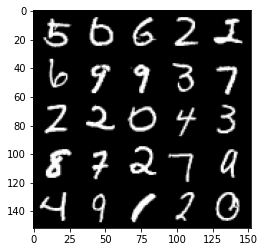

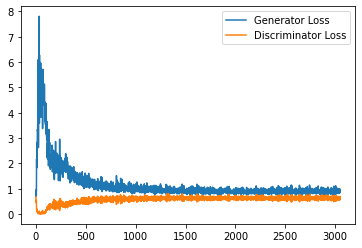

Step 61500: Generator loss: 0.9034241564273834, discriminator loss: 0.6233214885592461


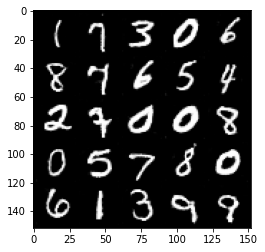

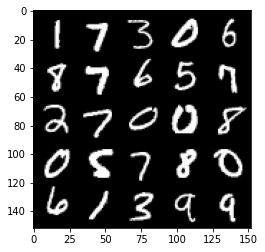

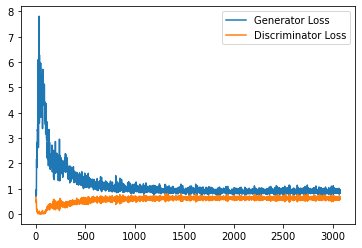

Step 62000: Generator loss: 0.9261748747825622, discriminator loss: 0.6182645394206047


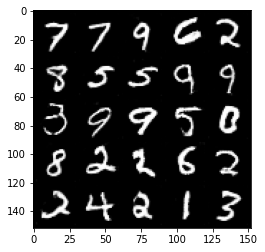

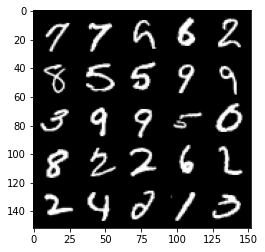

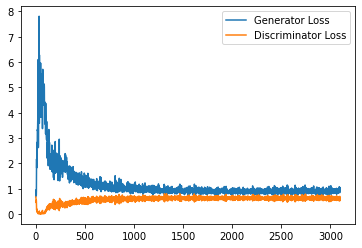

Step 62500: Generator loss: 0.9214378288984298, discriminator loss: 0.6276177208423614


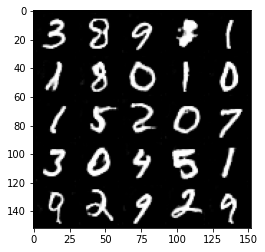

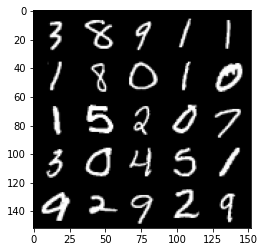

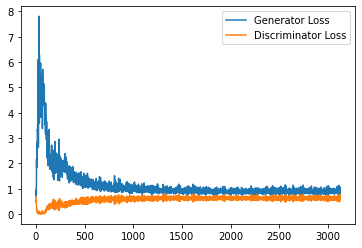

Step 63000: Generator loss: 0.9083204661607742, discriminator loss: 0.6223988702893257


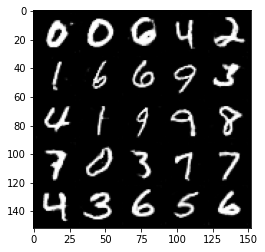

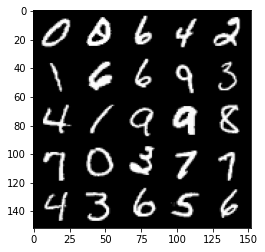

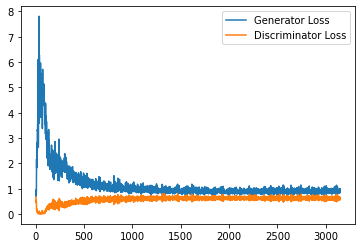

Step 63500: Generator loss: 0.9100207324028016, discriminator loss: 0.6247976858019829


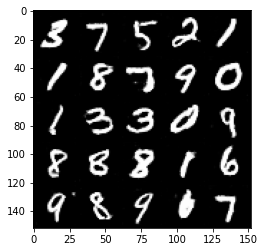

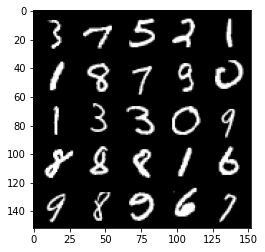

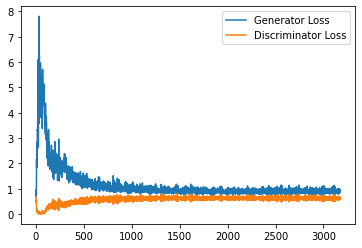

Step 64000: Generator loss: 0.9239307271242142, discriminator loss: 0.6150745962262154


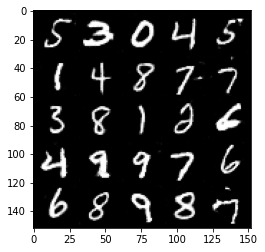

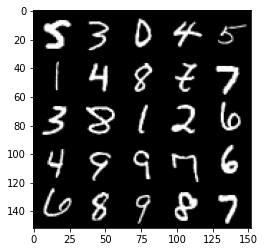

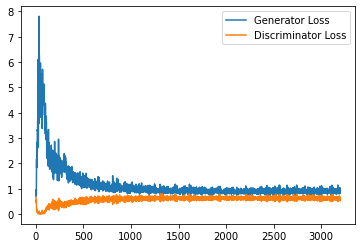

Step 64500: Generator loss: 0.9254251499176025, discriminator loss: 0.62035720962286


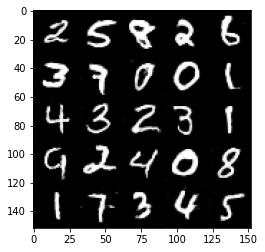

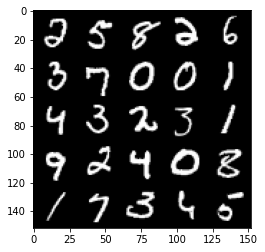

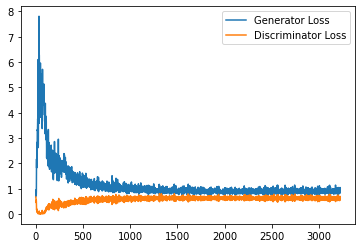

Step 65000: Generator loss: 0.9199267613887787, discriminator loss: 0.6229089397788048


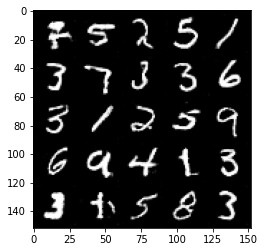

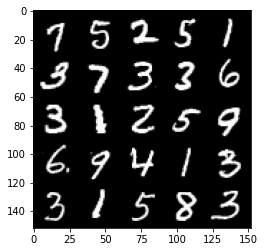

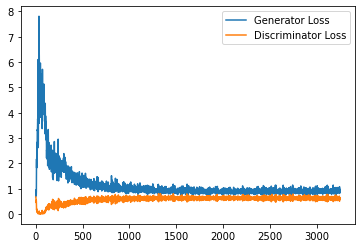

Step 65500: Generator loss: 0.9216199575662612, discriminator loss: 0.621632679104805


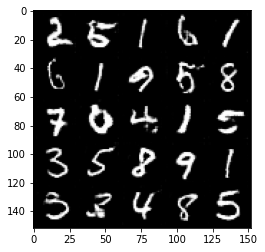

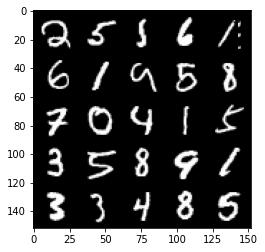

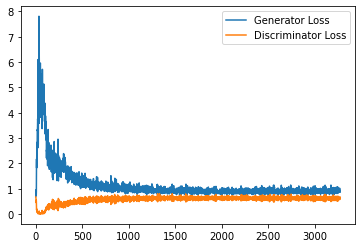

Step 66000: Generator loss: 0.9320274854898453, discriminator loss: 0.6208471950292588


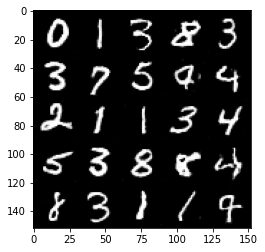

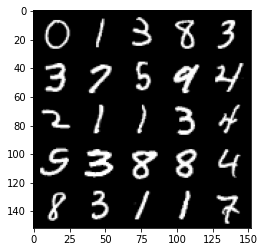

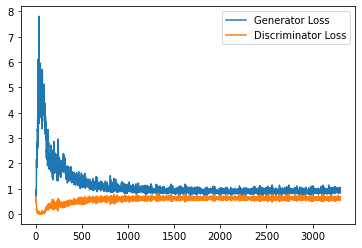

Step 66500: Generator loss: 0.921482438325882, discriminator loss: 0.6211947868466378


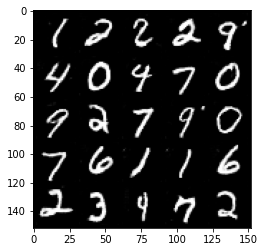

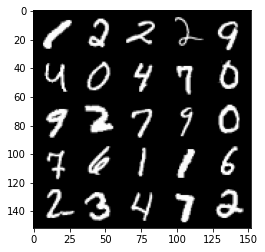

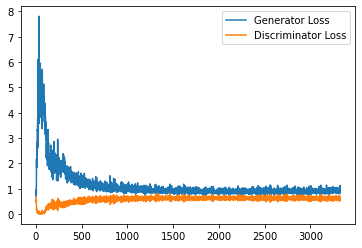

Step 67000: Generator loss: 0.9135016323328018, discriminator loss: 0.61908757853508


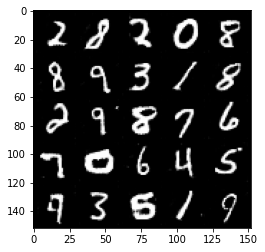

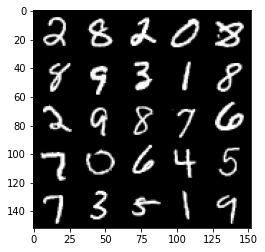

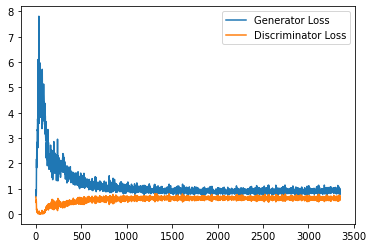

Step 67500: Generator loss: 0.9251233298778534, discriminator loss: 0.6175187063217163


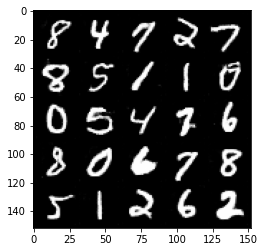

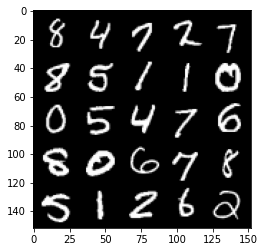

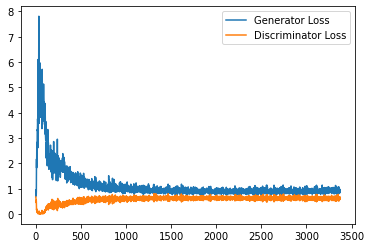

Step 68000: Generator loss: 0.9047435773611069, discriminator loss: 0.6161828082799912


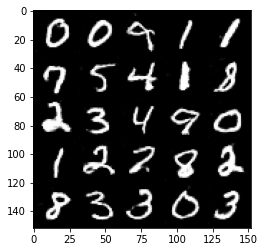

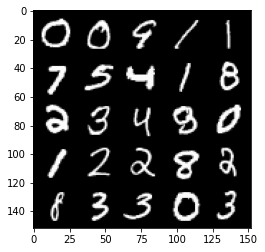

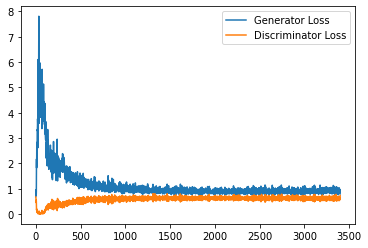

Step 68500: Generator loss: 0.9366049935817718, discriminator loss: 0.6105669956803322


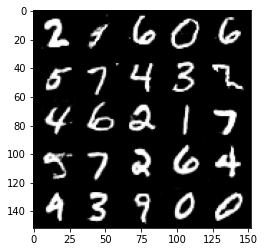

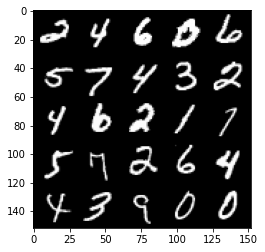

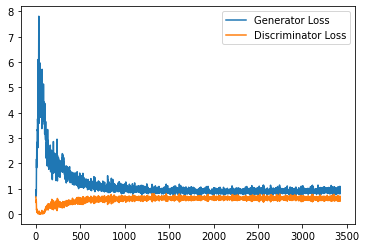

Step 69000: Generator loss: 0.9301925944089889, discriminator loss: 0.6206033946275711


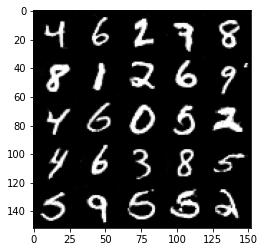

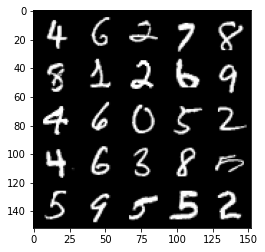

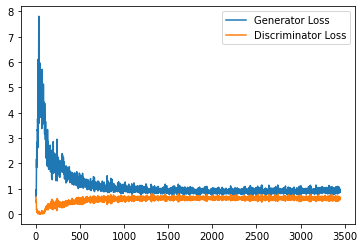

Step 69500: Generator loss: 0.922216094493866, discriminator loss: 0.6166184422969818


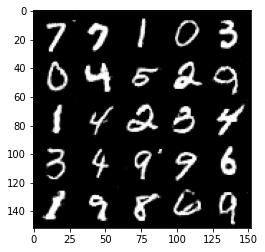

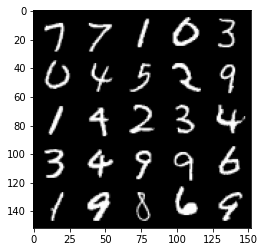

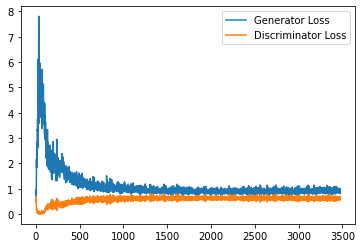

Step 70000: Generator loss: 0.9322884186506272, discriminator loss: 0.6127592761516572


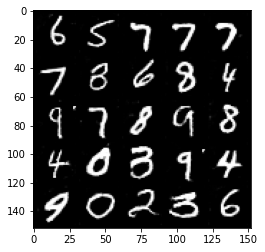

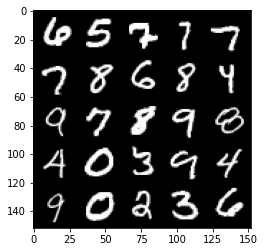

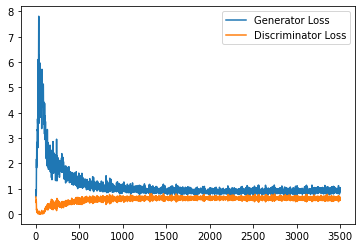

Step 70500: Generator loss: 0.9154365158081055, discriminator loss: 0.6244218631982803


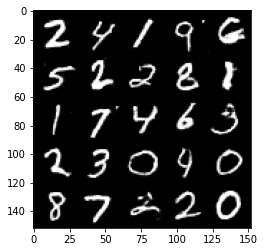

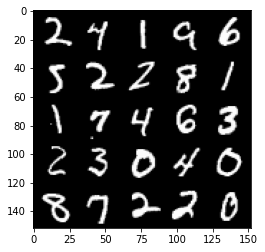

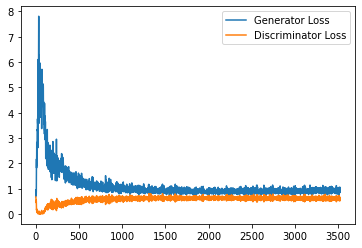

Step 71000: Generator loss: 0.9424646872282029, discriminator loss: 0.6174825989603996


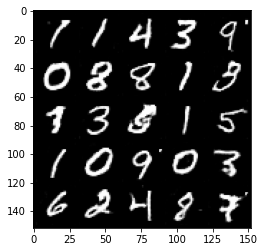

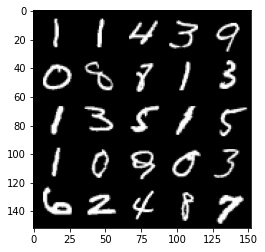

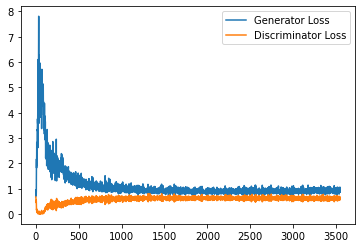

Step 71500: Generator loss: 0.9128357883691788, discriminator loss: 0.6231648681163788


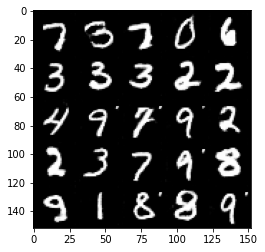

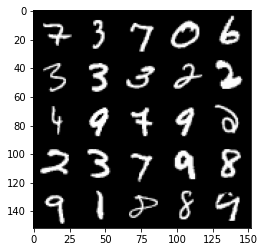

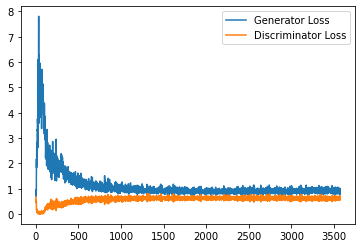

Step 72000: Generator loss: 0.9157537301778793, discriminator loss: 0.6182149212360382


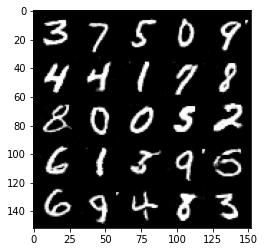

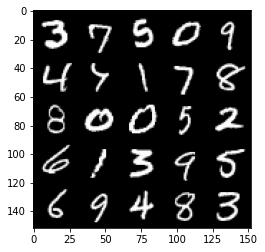

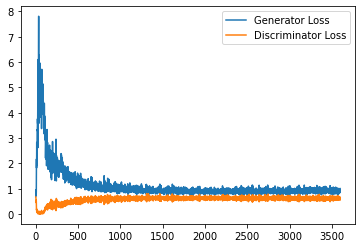

Step 72500: Generator loss: 0.9280122401714325, discriminator loss: 0.6179492207765579


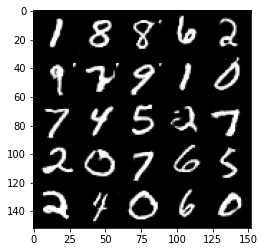

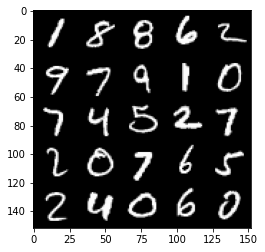

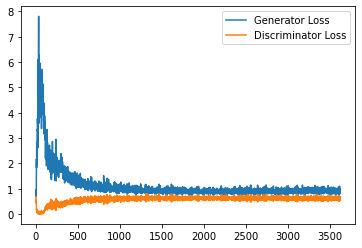

Step 73000: Generator loss: 0.9322188532352448, discriminator loss: 0.6147963401675224


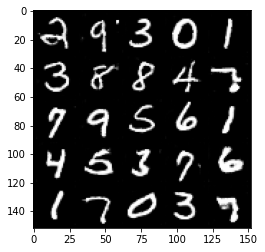

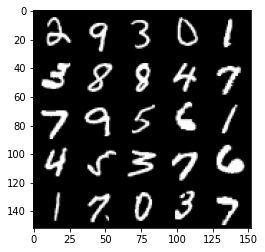

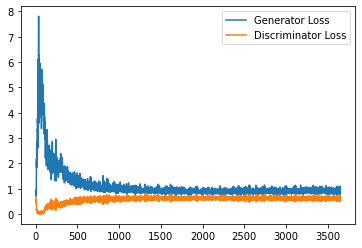

Step 73500: Generator loss: 0.9304953153133393, discriminator loss: 0.6132102937698364


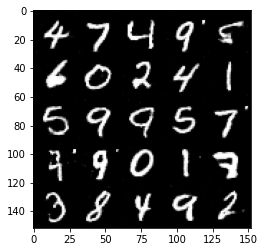

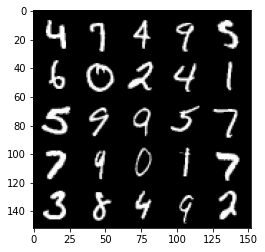

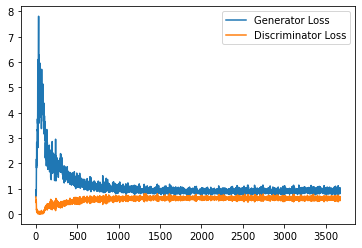

Step 74000: Generator loss: 0.924450367808342, discriminator loss: 0.6150070880651474


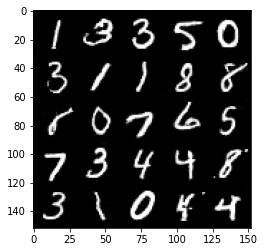

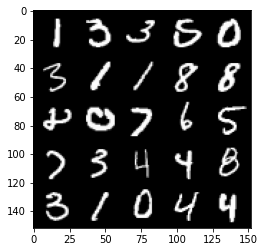

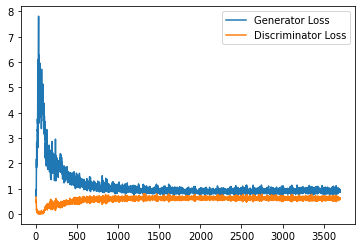

Step 74500: Generator loss: 0.9321169224977494, discriminator loss: 0.6158484692573547


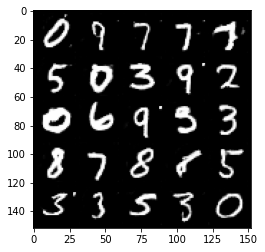

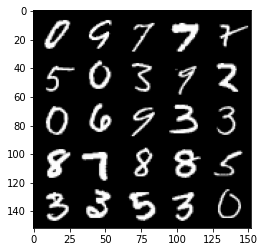

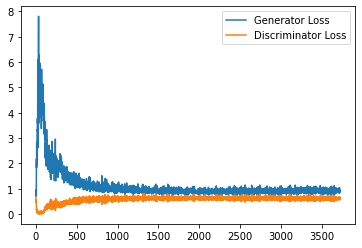

Step 75000: Generator loss: 0.9424843300580978, discriminator loss: 0.6189062063097954


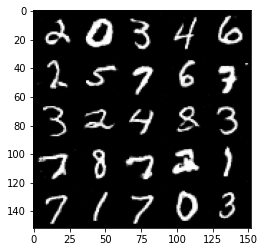

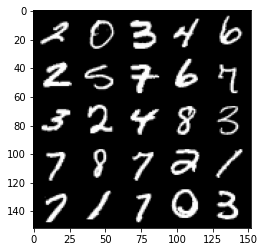

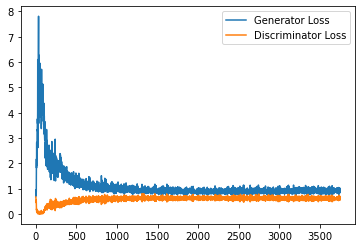

Step 75500: Generator loss: 0.9318445683717728, discriminator loss: 0.6129495474100113


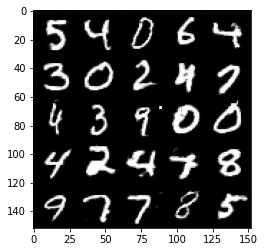

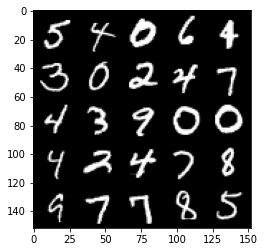

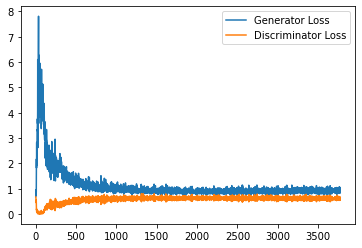

Step 76000: Generator loss: 0.9574115581512451, discriminator loss: 0.6118486191034317


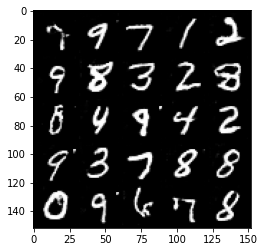

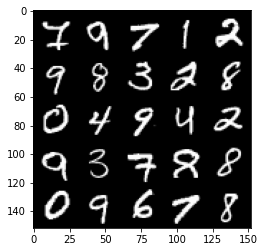

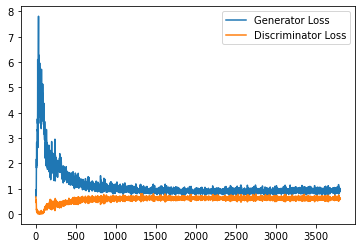

Step 76500: Generator loss: 0.92132168674469, discriminator loss: 0.6178664001226425


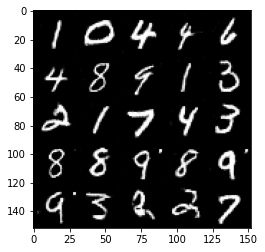

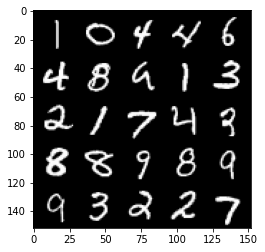

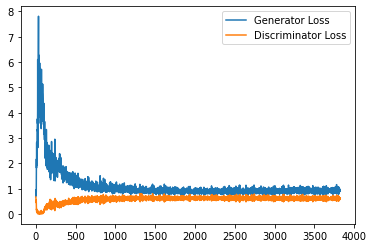

Step 77000: Generator loss: 0.9428064436912537, discriminator loss: 0.6121167474389076


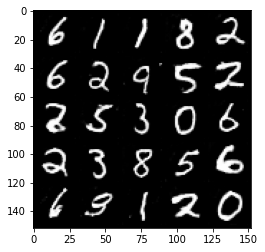

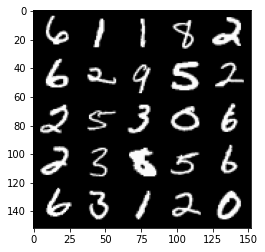

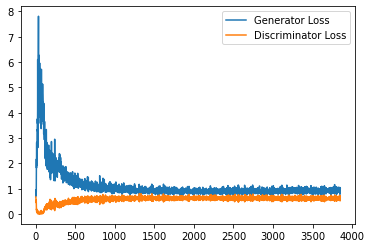

Step 77500: Generator loss: 0.9286568318605423, discriminator loss: 0.6172988721132279


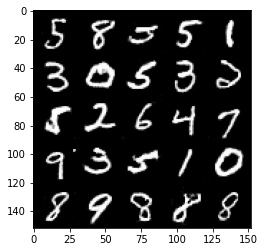

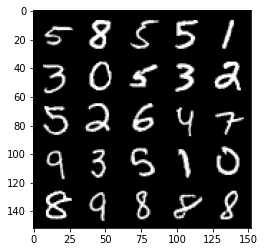

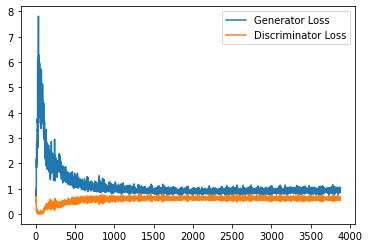

Step 78000: Generator loss: 0.9508309458494186, discriminator loss: 0.6193883658647538


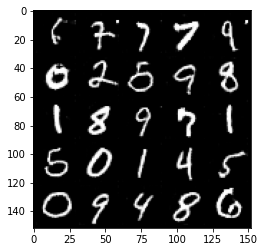

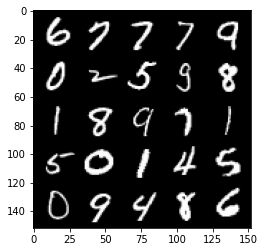

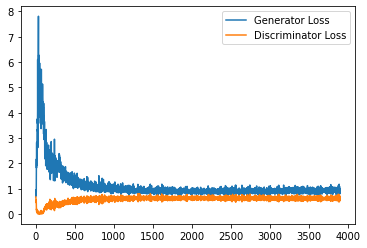

Step 80000: Generator loss: 0.9242351225614548, discriminator loss: 0.6147757611870766



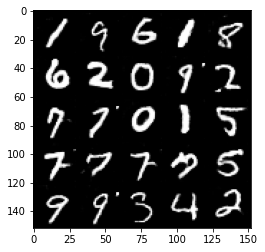

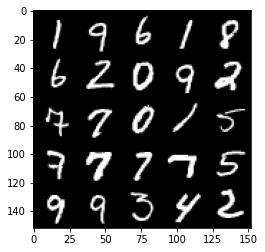

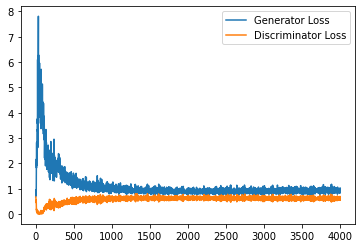

Step 80500: Generator loss: 0.9387473672628402, discriminator loss: 0.618300340950489


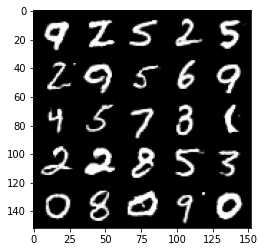

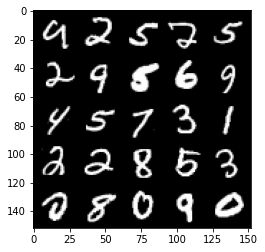

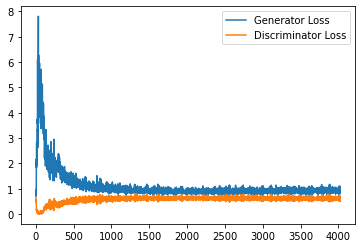

Step 81000: Generator loss: 0.9489685460329056, discriminator loss: 0.6128384500145913


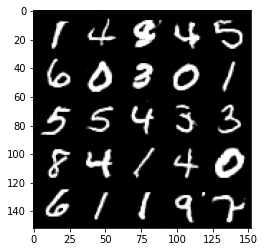

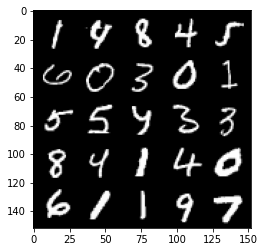

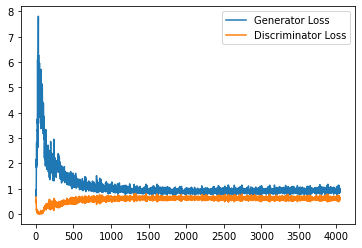

Step 81500: Generator loss: 0.9283504116535187, discriminator loss: 0.616123119354248


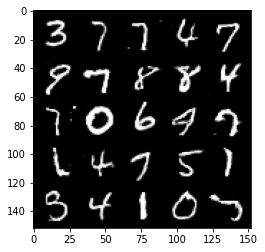

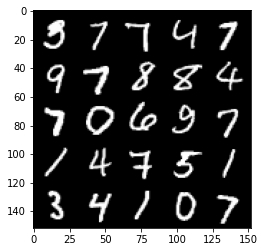

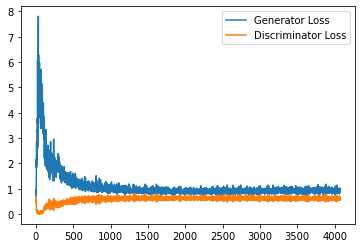

Step 82000: Generator loss: 0.9342299969792366, discriminator loss: 0.6175855762958526


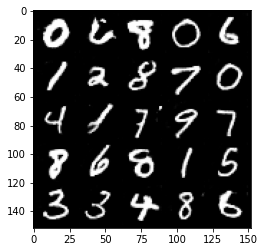

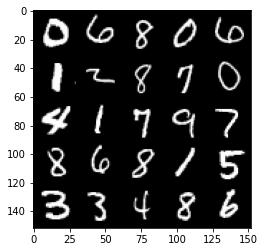

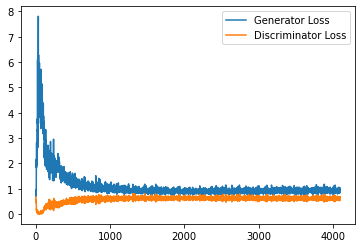

Step 82500: Generator loss: 0.9470746912360192, discriminator loss: 0.6102946185469628


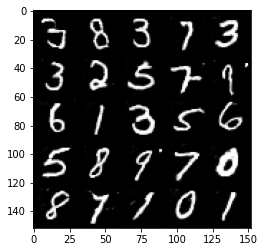

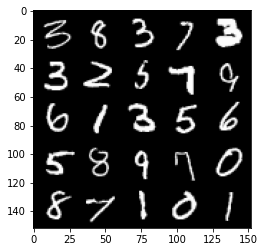

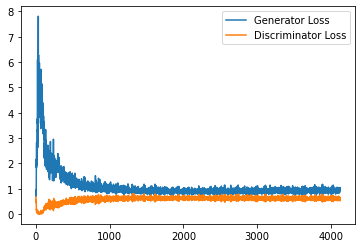

Step 83000: Generator loss: 0.937303671836853, discriminator loss: 0.6113321560621262


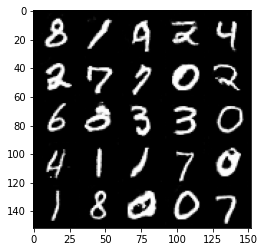

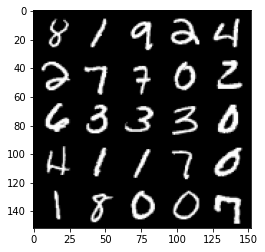

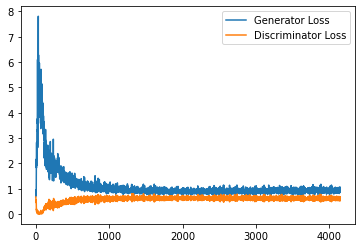

Step 83500: Generator loss: 0.9254848021268844, discriminator loss: 0.6205143038034439


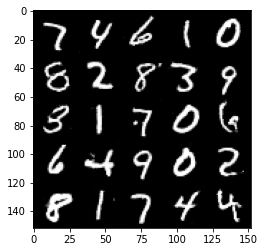

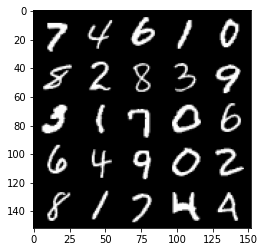

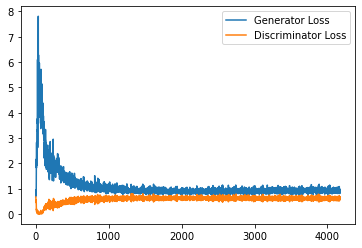

Step 84000: Generator loss: 0.9319777987003326, discriminator loss: 0.6143870951533318


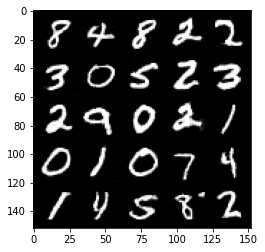

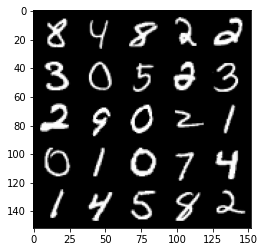

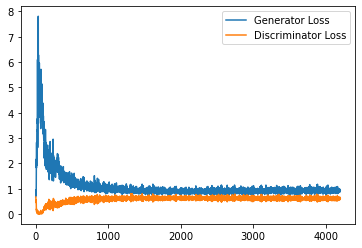

Step 84500: Generator loss: 0.9219816030263901, discriminator loss: 0.6181802117824554


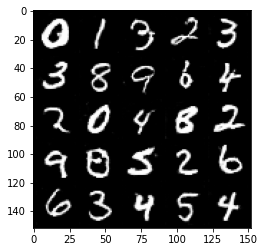

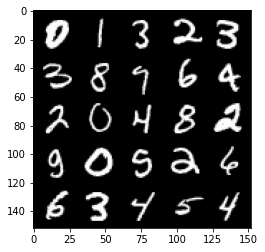

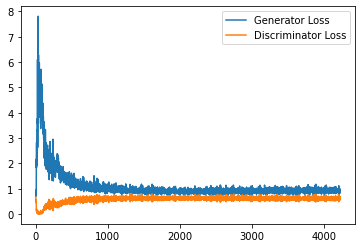

Step 85000: Generator loss: 0.9465013883113861, discriminator loss: 0.6092262915968895


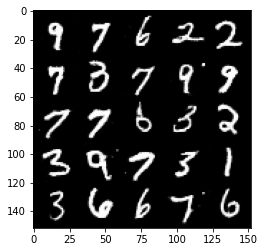

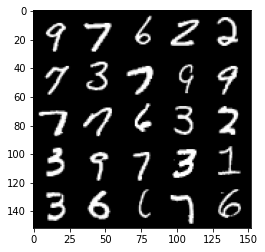

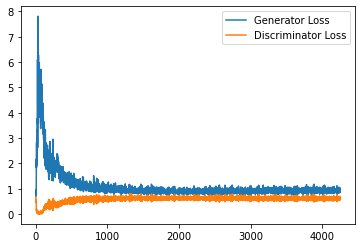

Step 85500: Generator loss: 0.9540820928812027, discriminator loss: 0.6107742075324059


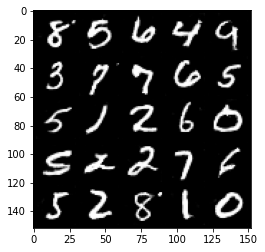

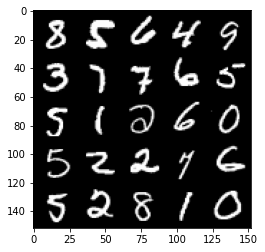

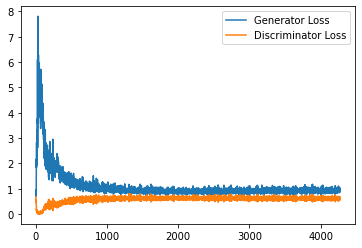

Step 86000: Generator loss: 0.9357891362905503, discriminator loss: 0.6167856866121292


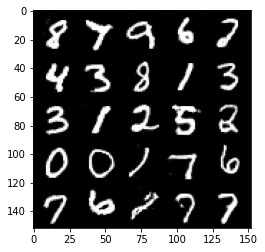

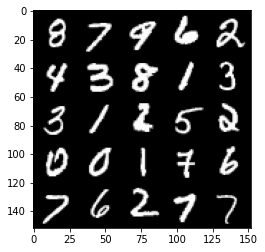

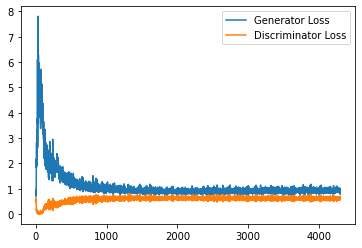

Step 86500: Generator loss: 0.9310028487443924, discriminator loss: 0.6123855706453324


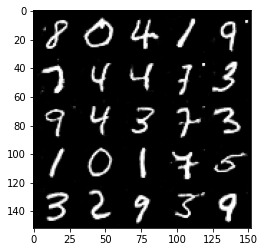

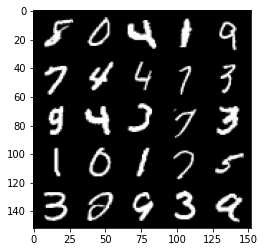

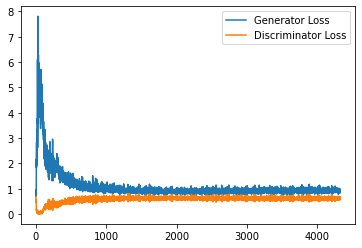

Step 87000: Generator loss: 0.9153098201751709, discriminator loss: 0.621179988026619


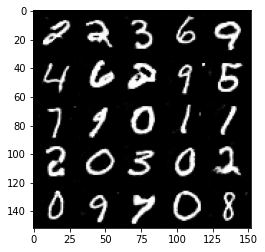

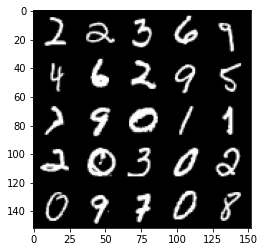

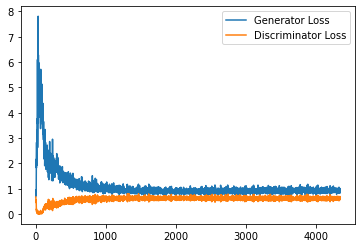

Step 87500: Generator loss: 0.9262848953008652, discriminator loss: 0.616970069527626


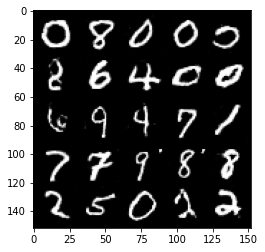

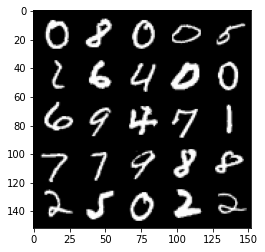

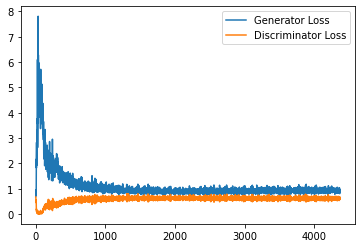

Step 88000: Generator loss: 0.9161616032123565, discriminator loss: 0.6197256346344948


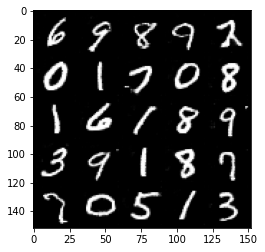

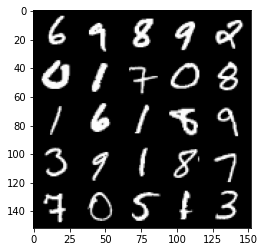

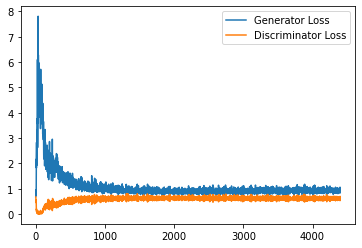

Step 88500: Generator loss: 0.9388740696907043, discriminator loss: 0.6191310664415359


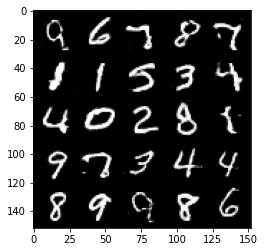

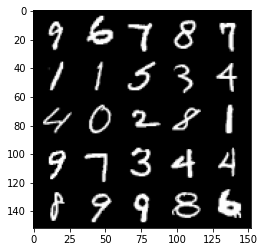

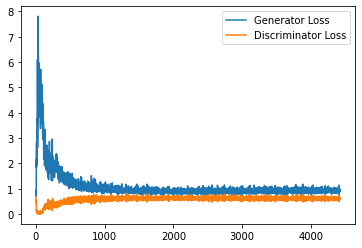

Step 89000: Generator loss: 0.9424136137962341, discriminator loss: 0.616693945467472


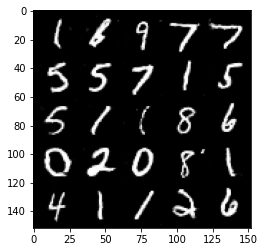

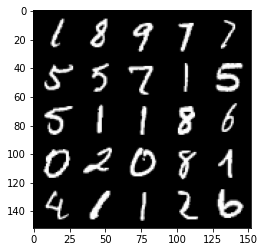

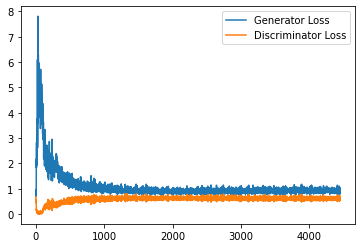

Step 89500: Generator loss: 0.9366898691654205, discriminator loss: 0.6142775457501412


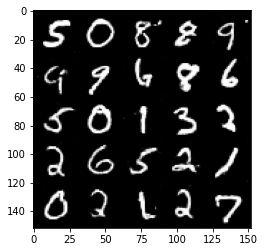

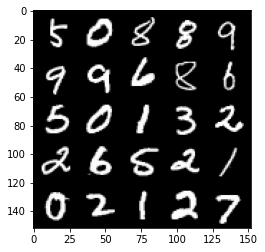

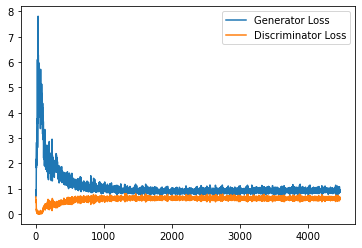

Step 90000: Generator loss: 0.9301814051866532, discriminator loss: 0.6164954617023468


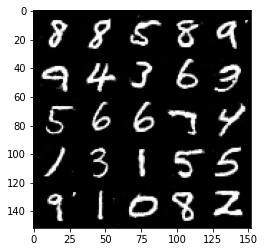

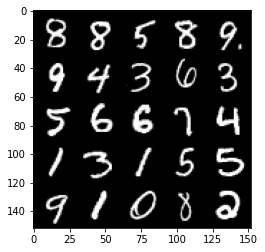

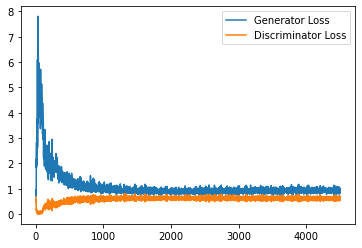

Step 90500: Generator loss: 0.9351705845594406, discriminator loss: 0.6187110497951508


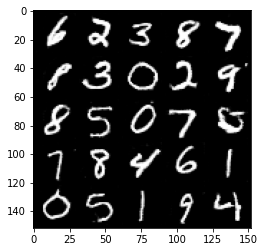

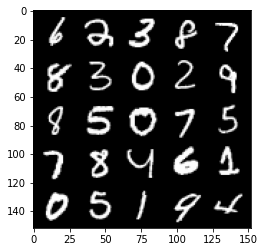

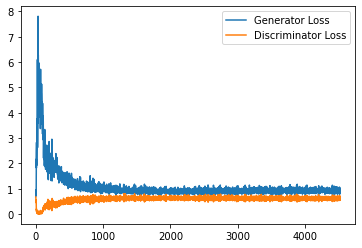

Step 91000: Generator loss: 0.9344545258283615, discriminator loss: 0.6166757326722145


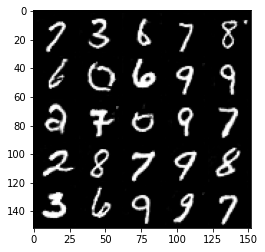

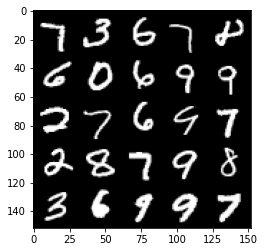

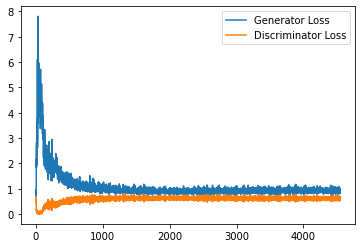

Step 91500: Generator loss: 0.9338233613967896, discriminator loss: 0.6158419628739357


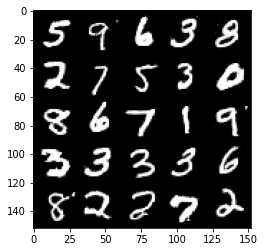

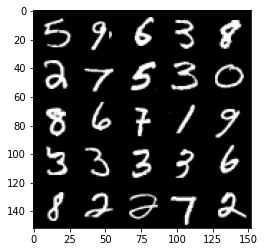

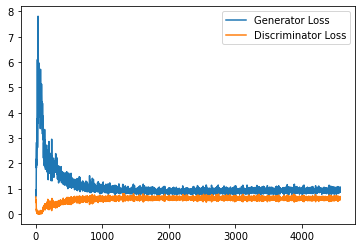

Step 92000: Generator loss: 0.9246086382865906, discriminator loss: 0.6146536382436752


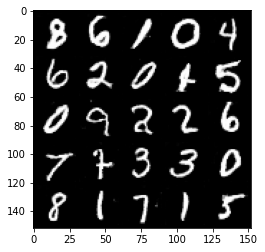

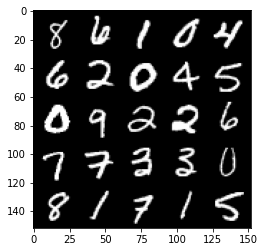

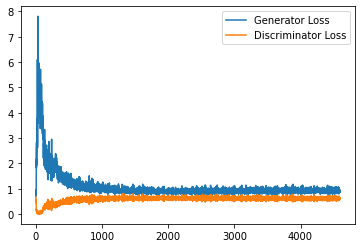

Step 92500: Generator loss: 0.9294882527589798, discriminator loss: 0.6141483746767044


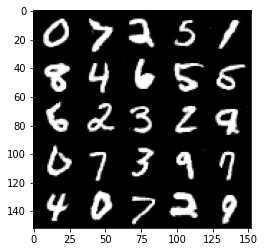

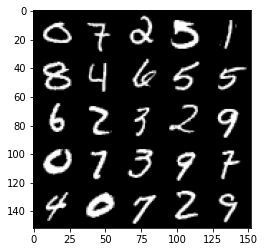

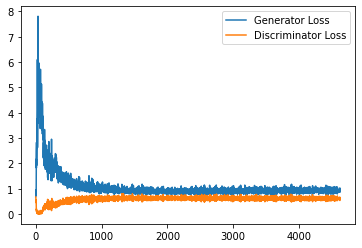

Step 93000: Generator loss: 0.9297647752761841, discriminator loss: 0.6138492953777314


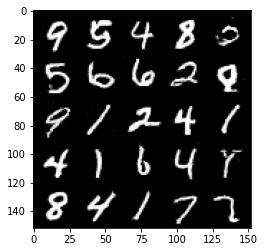

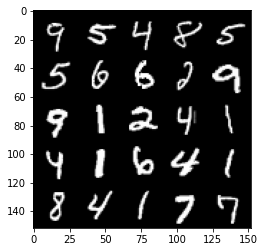

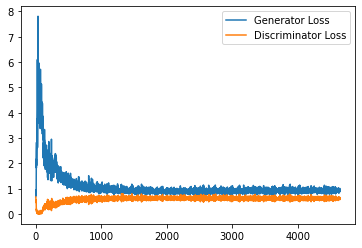

Step 93500: Generator loss: 0.95827290725708, discriminator loss: 0.6094971064925194


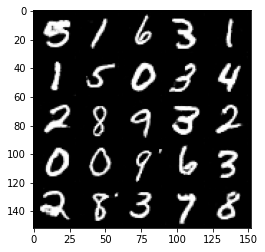

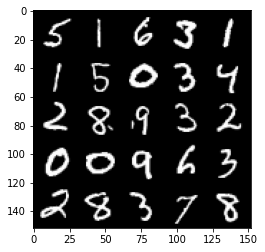

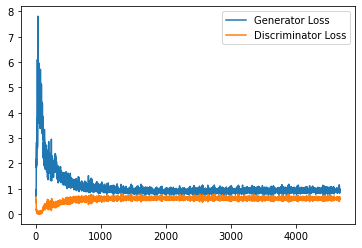

In [13]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])
        
        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [14]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

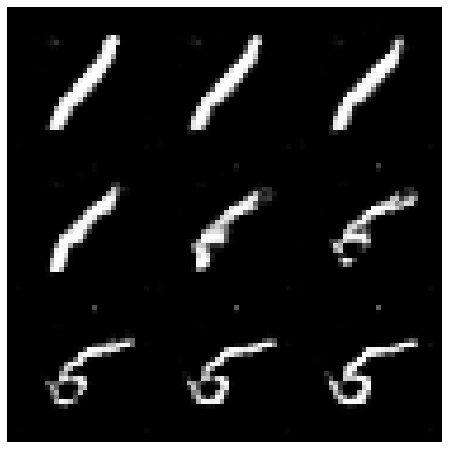

In [15]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

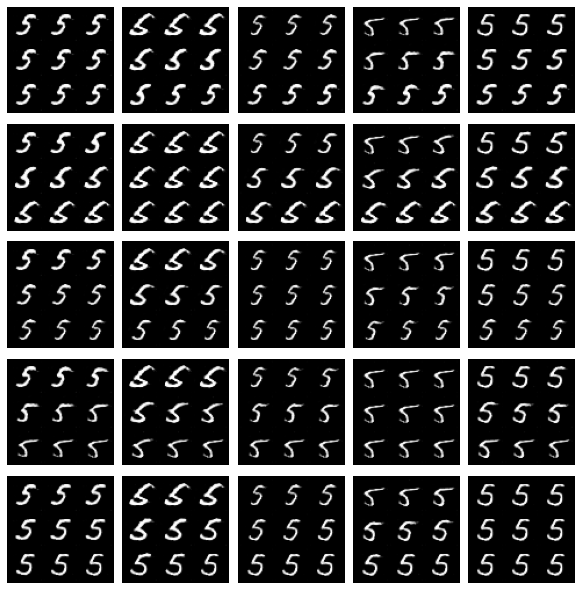

In [16]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()